In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.models import Sequential, Model
from keras.layers import *
from keras.optimizers.legacy import Adam
from keras.utils import plot_model
from keras.models import load_model, save_model
from keras.losses import BinaryCrossentropy
import cv2
import os

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
labels = ['PNEUMONIA', 'NORMAL']
img_size = 150
def get_training_data(data_dir):
    data = []
    for label in labels:
        path = os.path.join(data_dir, label)
        class_num = labels.index(label)
        for img in os.listdir(path):
            try:
                img_arr = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
                resized_arr = cv2.resize(img_arr, (img_size, img_size)) # Reshaping images to preferred size
                data.append([resized_arr, class_num])
            except Exception as e:
                print(e)
    return np.array(data)

In [ ]:
train = get_training_data('/content/gdrive/MyDrive/chest_xray/train')
test = get_training_data('/content/gdrive/MyDrive/chest_xray/test')
val = get_training_data('/content/gdrive/MyDrive/chest_xray/val')

OpenCV(4.8.0) /io/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'

OpenCV(4.8.0) /io/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'

OpenCV(4.8.0) /io/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'

OpenCV(4.8.0) /io/opencv/modules/imgproc/src/resize.cpp:4062: error: (-215:Assertion failed) !ssize.empty() in function 'resize'



In [ ]:
len(train)

5216

In [ ]:
def generate_x_y_train_test(arr):
  x = []
  y = []
  for i in range(len(arr)):
    x.append(arr[i][0])
    y.append(arr[i][1])
  return np.array(x),np.array(y)

In [ ]:
x_train, y_train = generate_x_y_train_test(train)
x_test, y_test = generate_x_y_train_test(test)
x_val, y_val = generate_x_y_train_test(val)

In [ ]:
pd.value_counts(y_train)

0    3875
1    1341
dtype: int64

In [ ]:
x_train = x_train/255
print(x_train.min(),x_train.max())

0.0 1.0


In [ ]:
total_epochs = 500
batch_size = 256
half_batch = 128

no_of_batches = int(x_train.shape[0]/batch_size)

noise_dim = 100

adam = Adam(lr = 2e-4, beta_1=0.5)

## Type - 1

In [ ]:
# template from github


def create_generator():
    generator = Sequential([
        Dense(units = 25*25*128, input_shape = (noise_dim,)),
        Reshape((25,25,128)),
        LeakyReLU(0.2),
        BatchNormalization(),
        Conv2DTranspose(64, kernel_size=(5,5), strides = (2,2), padding = 'same'),
        LeakyReLU(0.2),
        BatchNormalization(),
        Conv2DTranspose(1, kernel_size=(5,5), strides = (3,3), padding = 'same', activation = 'tanh'),
        LeakyReLU(0.2)
    ])

    generator.compile(loss = BinaryCrossentropy(),optimizer = Adam(lr=0.0002, beta_1=0.5))

    return generator


def create_discriminator():
    descriminator = Sequential([
        Conv2D(64, kernel_size=(5,5), strides=(3,3), padding='same', input_shape=(150,150,1)),
        LeakyReLU(0.2),
        Conv2D(128, kernel_size=(5,5), strides=(2,2), padding='same'),
        LeakyReLU(0.2),
        Flatten(),
        Dense(100),
        LeakyReLU(0.2),
        Dense(1, activation='sigmoid')
    ])

    descriminator.compile(loss = BinaryCrossentropy(), optimizer=Adam(lr=0.0002, beta_1=0.5))
    return descriminator


def create_gan(generator, discriminator, noise_dim):
    discriminator.trainable = False

    gan_input = Input(shape=(noise_dim,))
    generator_output = generator(gan_input)
    gan_output = discriminator(generator_output)

    gan = Model(inputs=gan_input, outputs=gan_output)
    gan.compile(loss=BinaryCrossentropy(), optimizer=Adam(lr=0.0002, beta_1=0.5))

    discriminator.trainable = True
    return gan

In [ ]:
generator = create_generator()
generator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 80000)             8080000   
                                                                 
 reshape (Reshape)           (None, 25, 25, 128)       0         
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 25, 25, 128)       0         
                                                                 
 batch_normalization (Batch  (None, 25, 25, 128)       512       
 Normalization)                                                  
                                                                 
 conv2d_transpose (Conv2DTr  (None, 50, 50, 64)        204864    
 anspose)                                                        
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 50, 50, 64)        0

In [ ]:
descriminator = create_discriminator()
descriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 50, 50, 64)        1664      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 50, 50, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 25, 25, 128)       204928    
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 25, 25, 128)       0         
                                                                 
 flatten (Flatten)           (None, 80000)             0         
                                                                 
 dense_1 (Dense)             (None, 100)               8000100   
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 100)              

In [ ]:
model = create_gan(generator, descriminator, noise_dim)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100)]             0         
                                                                 
 sequential (Sequential)     (None, 150, 150, 1)       8287233   
                                                                 
 sequential_1 (Sequential)   (None, 1)                 8206793   
                                                                 
Total params: 16494026 (62.92 MB)
Trainable params: 16493642 (62.92 MB)
Non-trainable params: 384 (1.50 KB)
_________________________________________________________________


## Type - 2

In [ ]:
# Generator

generator = Sequential([
    Dense(units = 25*25*128, input_shape = (noise_dim,)),
    Reshape((25,25,128)),
    LeakyReLU(0.2),
    BatchNormalization(),
    Conv2DTranspose(64, kernel_size=(5,5), strides = (2,2), padding = 'same'),
    LeakyReLU(0.2),
    BatchNormalization(),
    Conv2DTranspose(1, kernel_size=(5,5), strides = (3,3), padding = 'same', activation = 'tanh'),
    LeakyReLU(0.2)
])

generator.compile(loss = 'binary_crossentorpy',optimizer = adam)

generator.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_9 (Dense)             (None, 80000)             8080000   
                                                                 
 reshape_3 (Reshape)         (None, 25, 25, 128)       0         
                                                                 
 leaky_re_lu_18 (LeakyReLU)  (None, 25, 25, 128)       0         
                                                                 
 batch_normalization_6 (Bat  (None, 25, 25, 128)       512       
 chNormalization)                                                
                                                                 
 conv2d_transpose_6 (Conv2D  (None, 50, 50, 64)        204864    
 Transpose)                                                      
                                                                 
 leaky_re_lu_19 (LeakyReLU)  (None, 50, 50, 64)       

In [ ]:
# Discriminator

descriminator = Sequential([
    Conv2D(64, kernel_size=(5,5), strides=(3,3), padding='same', input_shape=(150,150,1)),
    LeakyReLU(0.2),
    Conv2D(128, kernel_size=(5,5), strides=(2,2), padding='same'),
    LeakyReLU(0.2),
    Flatten(),
    Dense(100),
    LeakyReLU(0.2),
    Dense(1, activation='sigmoid')
])

descriminator.compile(loss = 'binary_crossentropy', optimizer=adam)

descriminator.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 50, 50, 64)        1664      
                                                                 
 leaky_re_lu_21 (LeakyReLU)  (None, 50, 50, 64)        0         
                                                                 
 conv2d_7 (Conv2D)           (None, 25, 25, 128)       204928    
                                                                 
 leaky_re_lu_22 (LeakyReLU)  (None, 25, 25, 128)       0         
                                                                 
 flatten_3 (Flatten)         (None, 80000)             0         
                                                                 
 dense_10 (Dense)            (None, 100)               8000100   
                                                                 
 leaky_re_lu_23 (LeakyReLU)  (None, 100)              

In [ ]:
# combined model

descriminator.trainable = False

gan_input = Input(shape = (noise_dim, ))
generated_img = generator(gan_input)
gan_output = descriminator(generated_img)
model = Model(gan_input, gan_output)

model.compile(loss = 'binary_crossentropy',optimizer = adam)

In [ ]:
model.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 100)]             0         
                                                                 
 sequential_6 (Sequential)   (None, 150, 150, 1)       8287233   
                                                                 
 sequential_7 (Sequential)   (None, 1)                 8206793   
                                                                 
Total params: 16494026 (62.92 MB)
Trainable params: 8286849 (31.61 MB)
Non-trainable params: 8207177 (31.31 MB)
_________________________________________________________________


## Training

In [ ]:
x_train = x_train.reshape(-1,150,150,1)
x_train.shape

(5216, 150, 150, 1)

In [ ]:
x_train_normal = np.array([x_train[i] for i in range(len(x_train)) if y_train[i]==1])
y_train_normal = np.array([y_train[i] for i in range(len(y_train)) if y_train[i]==1])

In [ ]:
x_train_normal.shape

(1341, 150, 150, 1)

In [ ]:
def display_images(samples = 25):
  noise = np.random.normal(0,1,size = (samples,noise_dim))
  generated_img = generator.predict(noise)
  plt.figure(figsize=(10,10))
  for i in range(samples):
    plt.subplot(5,5,i+1)
    plt.imshow(generated_img[i].reshape(150,150), cmap='gray')
    plt.axis('off')

  plt.show()

Epoch 1, Disc loss 0.1926974861533381, Generator loss 5.165481495857239
Epoch 2, Disc loss 0.19361743106273935, Generator loss 5.285747337341308
Epoch 3, Disc loss 0.18919801835436373, Generator loss 5.135930442810059
Epoch 4, Disc loss 0.18794390379916875, Generator loss 5.045991444587708
Epoch 5, Disc loss 0.19368345462717115, Generator loss 4.681602275371551
Epoch 6, Disc loss 0.18606629529967905, Generator loss 3.4382728099823
Epoch 7, Disc loss 0.1750549360876903, Generator loss 1.9521026998758315
Epoch 8, Disc loss 0.1744291688199155, Generator loss 2.125153216719627
Epoch 9, Disc loss 0.22731210611527786, Generator loss 2.778364196419716
Epoch 10, Disc loss 1.1195561792701483, Generator loss 3.456315764784813
1/1 [==============================] - 0s 19ms/step


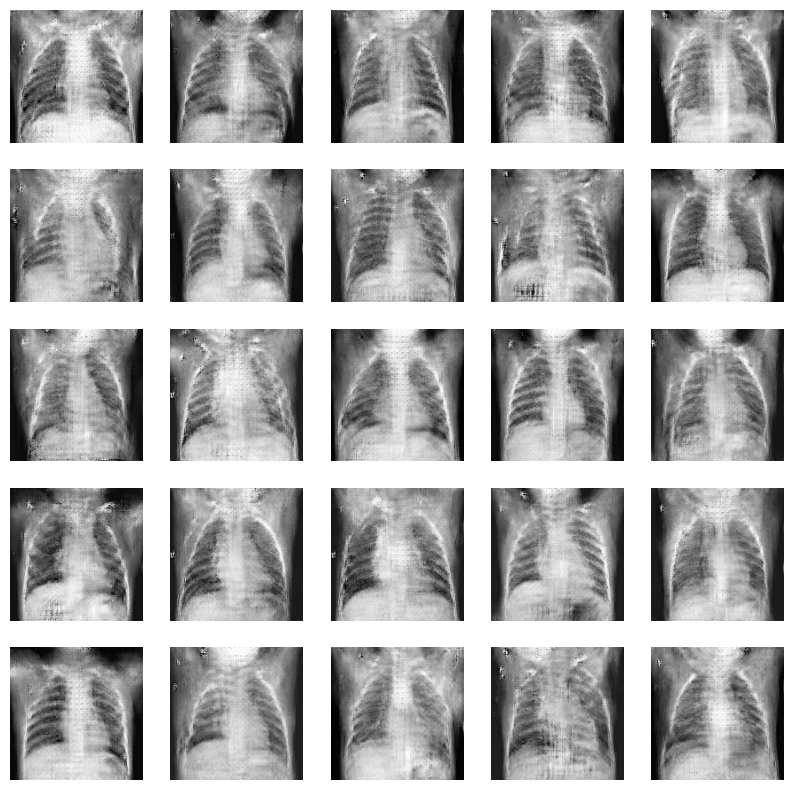

Epoch 11, Disc loss 0.3568601100705564, Generator loss 1.483774369955063
Epoch 12, Disc loss 0.379835497867316, Generator loss 2.8021419644355774
Epoch 13, Disc loss 0.336829281039536, Generator loss 3.874835479259491
Epoch 14, Disc loss 0.34238073849119244, Generator loss 3.867091727256775
Epoch 15, Disc loss 0.3021835824940354, Generator loss 5.02470223903656
Epoch 16, Disc loss 0.2552636206150055, Generator loss 4.965612781047821
Epoch 17, Disc loss 0.2080748823704198, Generator loss 3.619158172607422
Epoch 18, Disc loss 0.20070545666385442, Generator loss 3.4694868087768556
Epoch 19, Disc loss 0.21345095892902463, Generator loss 4.021444487571716
Epoch 20, Disc loss 0.20140602129977198, Generator loss 4.619447648525238
1/1 [==============================] - 0s 48ms/step


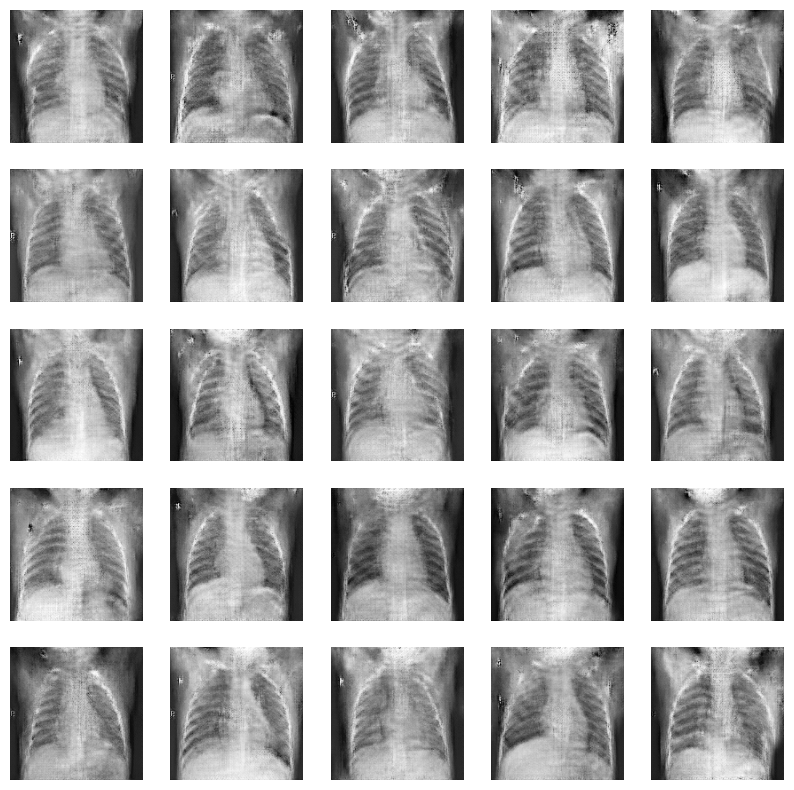

Epoch 21, Disc loss 0.2007575238822028, Generator loss 4.817766165733337
Epoch 22, Disc loss 0.19996574034448714, Generator loss 4.969771361351013
Epoch 23, Disc loss 0.20253025544807315, Generator loss 4.88765264749527
Epoch 24, Disc loss 0.19493372153956443, Generator loss 4.994166421890259
Epoch 25, Disc loss 0.19601462127175182, Generator loss 4.851993584632874
Epoch 26, Disc loss 0.2017667530104518, Generator loss 4.6227932333946224
Epoch 27, Disc loss 0.20085192249389366, Generator loss 4.516989827156067
Epoch 28, Disc loss 0.19133419140707703, Generator loss 3.6416324734687806
Epoch 29, Disc loss 0.18086633830098436, Generator loss 2.4429479956626894
Epoch 30, Disc loss 0.17946751517010853, Generator loss 2.0357236564159393
1/1 [==============================] - 0s 19ms/step


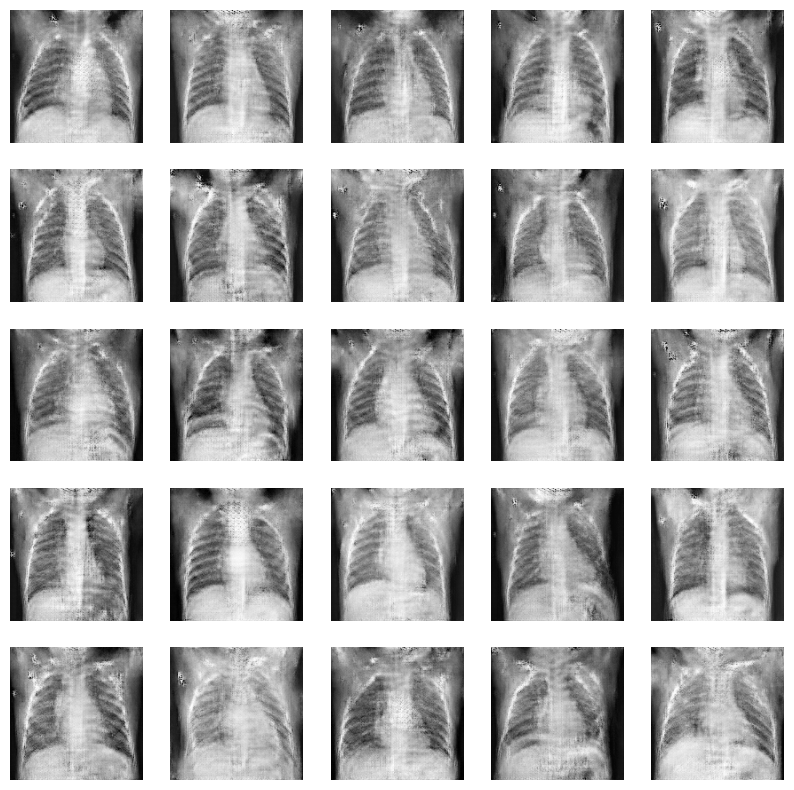

Epoch 31, Disc loss 0.17902860373724253, Generator loss 2.1856274157762527
Epoch 32, Disc loss 0.8930796840693802, Generator loss 3.2015097588300705
Epoch 33, Disc loss 0.5486083757132292, Generator loss 0.8813586860895157
Epoch 34, Disc loss 0.6066571533679962, Generator loss 1.2369886994361878
Epoch 35, Disc loss 0.6319282963871956, Generator loss 1.705638301372528
Epoch 36, Disc loss 0.5493874430656434, Generator loss 2.1876511096954347
Epoch 37, Disc loss 0.4679986611008644, Generator loss 3.0043702960014342
Epoch 38, Disc loss 0.3821463080123067, Generator loss 3.6758573174476625
Epoch 39, Disc loss 0.3227255206555128, Generator loss 3.9740249156951903
Epoch 40, Disc loss 0.3004737880080938, Generator loss 3.7321162462234496
1/1 [==============================] - 0s 18ms/step


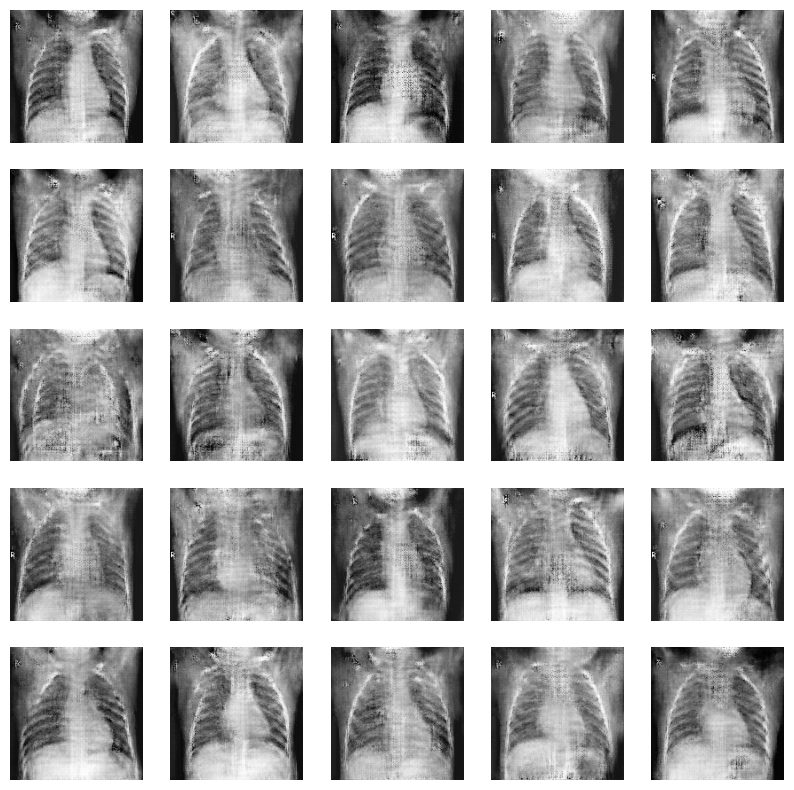

Epoch 41, Disc loss 0.2771406700368971, Generator loss 3.584835958480835
Epoch 42, Disc loss 0.24424807596951723, Generator loss 3.8006129026412965
Epoch 43, Disc loss 0.2534301416017115, Generator loss 3.975654935836792
Epoch 44, Disc loss 0.25225269412621854, Generator loss 4.42695826292038
Epoch 45, Disc loss 0.2501055071596056, Generator loss 4.735177969932556
Epoch 46, Disc loss 0.24659855514764786, Generator loss 4.654846596717834
Epoch 47, Disc loss 0.23636076813563706, Generator loss 3.914778846502304
Epoch 48, Disc loss 0.30653007146902383, Generator loss 2.997721728682518
Epoch 49, Disc loss 0.3654997494537383, Generator loss 2.4528866589069365
Epoch 50, Disc loss 0.2903712440049276, Generator loss 4.170512562990188
1/1 [==============================] - 0s 18ms/step


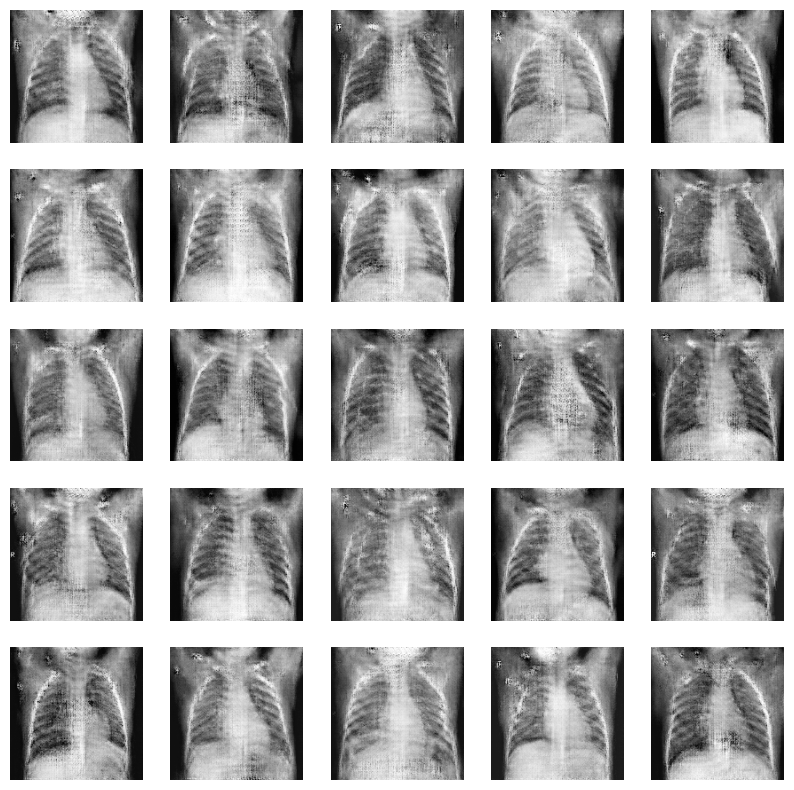

Epoch 51, Disc loss 0.30451174899935723, Generator loss 5.1426335096359255
Epoch 52, Disc loss 0.477318618632853, Generator loss 3.654583489894867
Epoch 53, Disc loss 0.2581780099309981, Generator loss 5.105761039257049
Epoch 54, Disc loss 0.2612656055018306, Generator loss 5.473869001865387
Epoch 55, Disc loss 0.19711483556311576, Generator loss 4.049515664577484
Epoch 56, Disc loss 0.20232140247244387, Generator loss 3.9853528141975403
Epoch 57, Disc loss 0.21937887282110752, Generator loss 4.480445635318756
Epoch 58, Disc loss 0.21894850325770676, Generator loss 4.468507146835327
Epoch 59, Disc loss 0.21710649896413087, Generator loss 4.82012380361557
Epoch 60, Disc loss 0.2164928471436724, Generator loss 4.9887700319290165
1/1 [==============================] - 0s 17ms/step


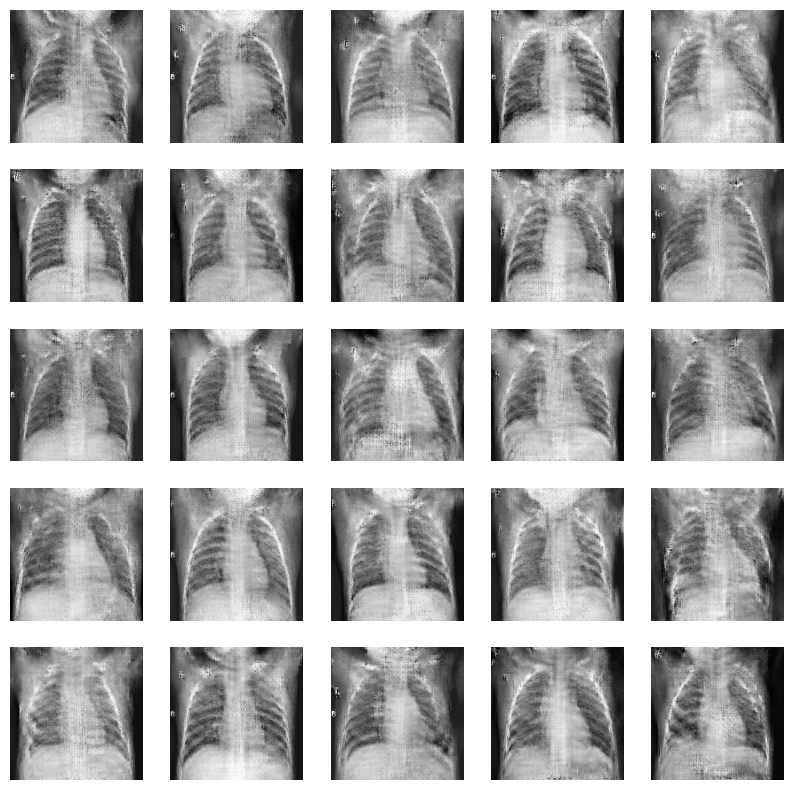

Epoch 61, Disc loss 0.216097472445108, Generator loss 4.939345598220825
Epoch 62, Disc loss 0.20096371292602272, Generator loss 4.918711113929748
Epoch 63, Disc loss 0.21734334935899824, Generator loss 4.792229056358337
Epoch 64, Disc loss 0.20309960279846564, Generator loss 3.8677504003047942
Epoch 65, Disc loss 0.34443001945037394, Generator loss 2.674078458547592
Epoch 66, Disc loss 0.3186274325475097, Generator loss 2.526455482840538
Epoch 67, Disc loss 0.2902115664910525, Generator loss 4.6011484384536745
Epoch 68, Disc loss 0.2642070854548365, Generator loss 5.192399358749389
Epoch 69, Disc loss 0.24115807795897126, Generator loss 5.419474959373474
Epoch 70, Disc loss 0.23468622318468987, Generator loss 5.705272221565247
1/1 [==============================] - 0s 33ms/step


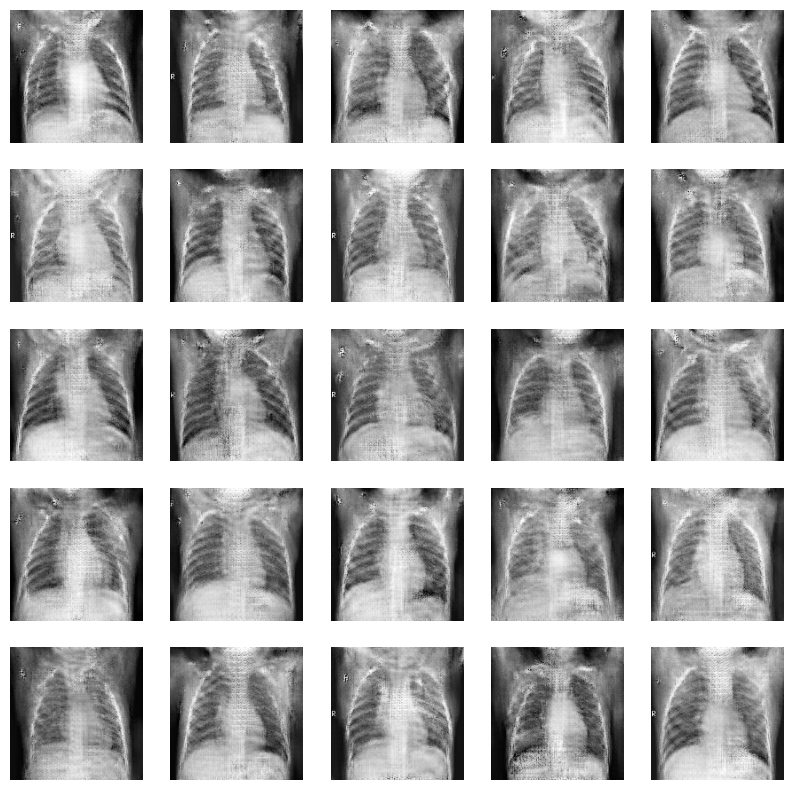

Epoch 71, Disc loss 0.23969789687544107, Generator loss 5.782186484336853
Epoch 72, Disc loss 0.27640490885823965, Generator loss 5.774508142471314
Epoch 73, Disc loss 0.2437881350517273, Generator loss 5.3779186606407166
Epoch 74, Disc loss 0.24858267358504235, Generator loss 5.293795692920685
Epoch 75, Disc loss 0.2334044822026044, Generator loss 5.71235339641571
Epoch 76, Disc loss 0.22511068354360758, Generator loss 5.3239295959472654
Epoch 77, Disc loss 0.2365723426453769, Generator loss 5.695621514320374
Epoch 78, Disc loss 0.21931280919816346, Generator loss 5.824284911155701
Epoch 79, Disc loss 0.2099195197049994, Generator loss 5.542176783084869
Epoch 80, Disc loss 0.20377008201467106, Generator loss 4.911536312103271
1/1 [==============================] - 0s 19ms/step


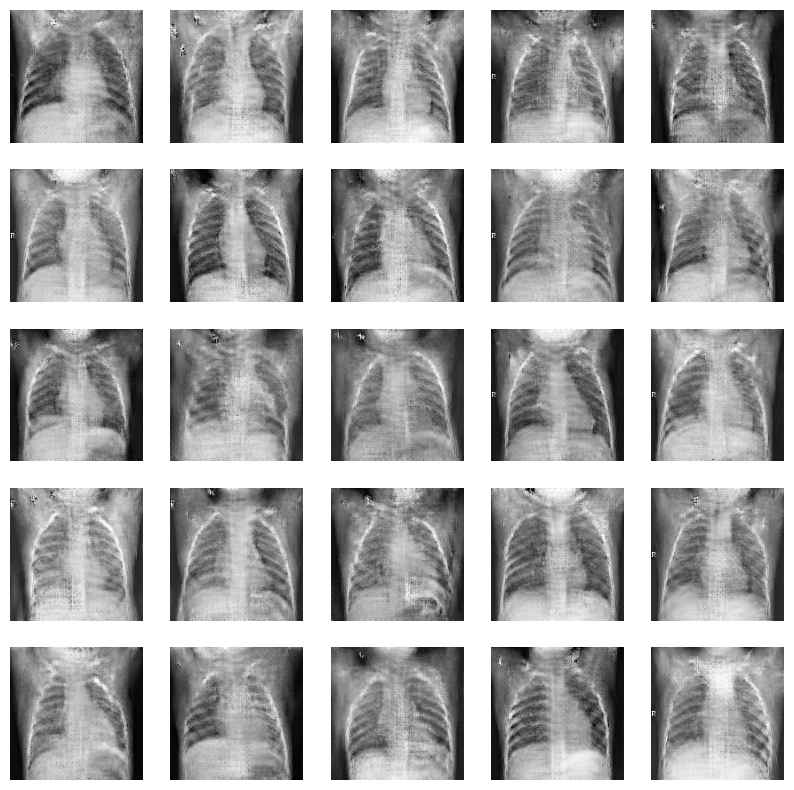

Epoch 81, Disc loss 0.17950223157567963, Generator loss 3.915949082374573
Epoch 82, Disc loss 0.1816089949774323, Generator loss 4.039354920387268
Epoch 83, Disc loss 0.18231345513486302, Generator loss 4.558540606498719
Epoch 84, Disc loss 0.18966932096518577, Generator loss 4.694656240940094
Epoch 85, Disc loss 0.17997353241953534, Generator loss 5.093241429328918
Epoch 86, Disc loss 0.18751975224586204, Generator loss 5.224354994297028
Epoch 87, Disc loss 0.182367446256103, Generator loss 5.48838210105896
Epoch 88, Disc loss 0.19134182727430016, Generator loss 5.6219900965690615
Epoch 89, Disc loss 0.19031473863869905, Generator loss 5.216551518440246
Epoch 90, Disc loss 0.18211892943363636, Generator loss 5.415299201011658
1/1 [==============================] - 0s 29ms/step


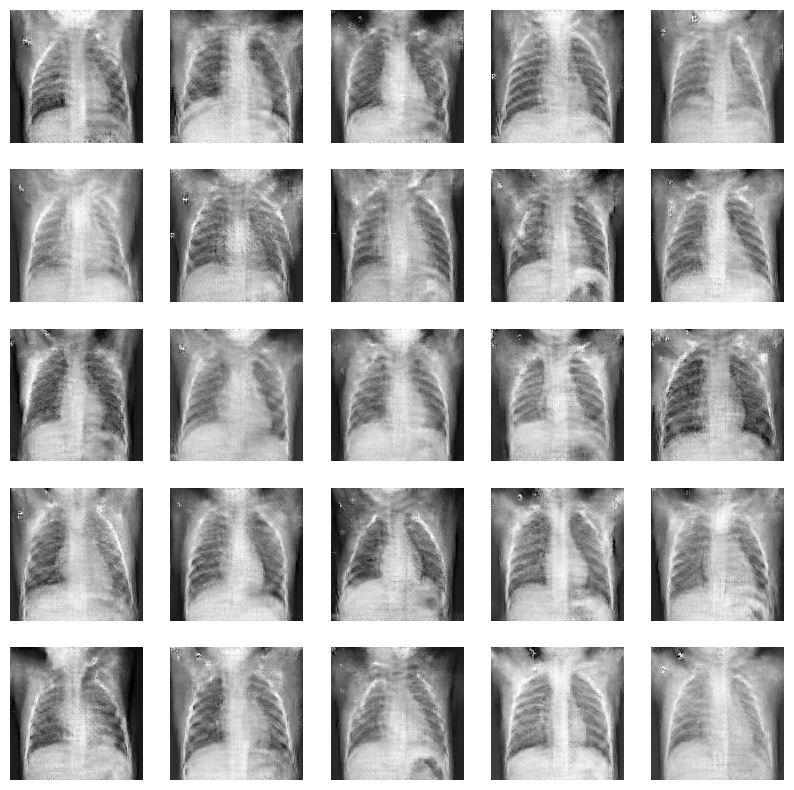

Epoch 91, Disc loss 0.18547685077646747, Generator loss 5.403441596031189
Epoch 92, Disc loss 0.18590561421588064, Generator loss 5.368772172927857
Epoch 93, Disc loss 0.2013106112368405, Generator loss 5.625168800354004
Epoch 94, Disc loss 0.18669636885169894, Generator loss 5.06280562877655
Epoch 95, Disc loss 0.1820927343564108, Generator loss 5.2326271533966064
Epoch 96, Disc loss 0.18653012465219945, Generator loss 5.362692666053772
Epoch 97, Disc loss 0.19245668016374112, Generator loss 5.072009134292602
Epoch 98, Disc loss 0.18932235444663092, Generator loss 5.2189905643463135
Epoch 99, Disc loss 0.18820970572996884, Generator loss 5.3073466420173645
Epoch 100, Disc loss 0.1845260106958449, Generator loss 5.459137511253357
1/1 [==============================] - 0s 18ms/step


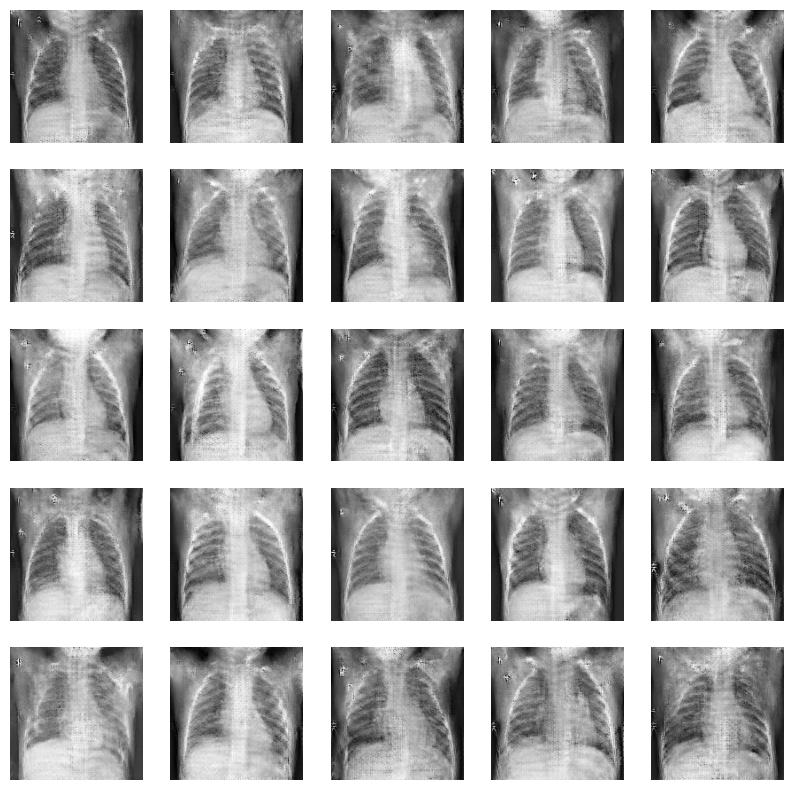

Epoch 101, Disc loss 0.19473960421746597, Generator loss 5.338279843330383
Epoch 102, Disc loss 0.18737896396778525, Generator loss 5.278633666038513
Epoch 103, Disc loss 0.18771583824418486, Generator loss 5.354330444335938
Epoch 104, Disc loss 0.18495697354665025, Generator loss 5.496978545188904
Epoch 105, Disc loss 0.18784637260250747, Generator loss 5.307647478580475
Epoch 106, Disc loss 0.19479448221391066, Generator loss 5.22980819940567
Epoch 107, Disc loss 0.18304089377634228, Generator loss 5.033130550384522
Epoch 108, Disc loss 0.18588213417679073, Generator loss 4.029493129253387
Epoch 109, Disc loss 0.19077948495396413, Generator loss 3.662629634141922
Epoch 110, Disc loss 0.2407649149768986, Generator loss 4.541548585891723
1/1 [==============================] - 0s 18ms/step


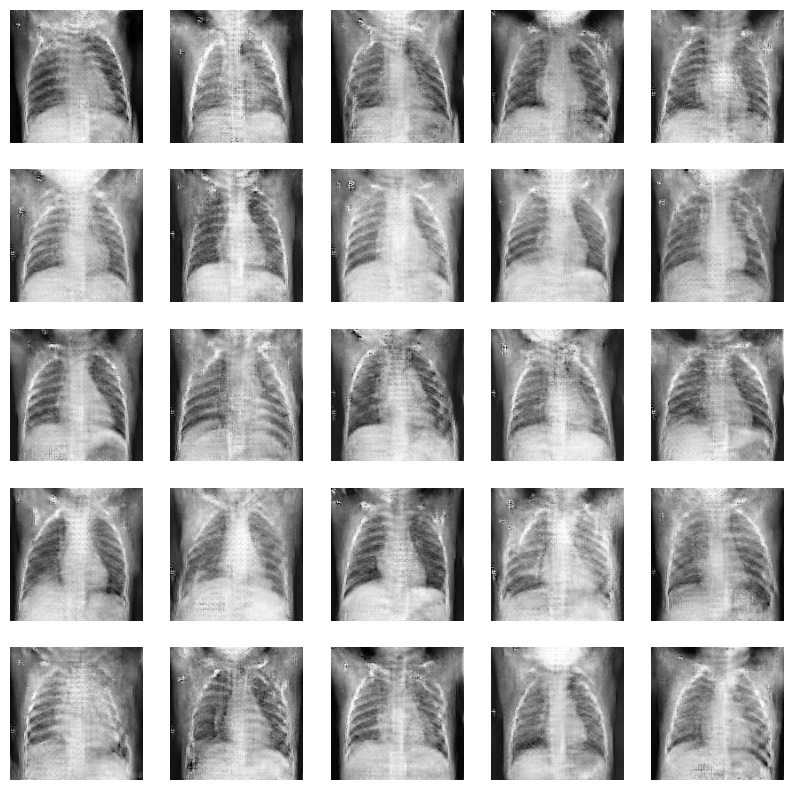

Epoch 111, Disc loss 0.19682569517754017, Generator loss 4.085839575529098
Epoch 112, Disc loss 0.2344962585979374, Generator loss 4.724909496307373
Epoch 113, Disc loss 0.19342689551995135, Generator loss 5.067712295055389
Epoch 114, Disc loss 0.260027019190602, Generator loss 5.640544760227203
Epoch 115, Disc loss 0.2097378089092672, Generator loss 5.880147218704224
Epoch 116, Disc loss 0.22907245117530692, Generator loss 6.051608979701996
Epoch 117, Disc loss 0.2868156405398622, Generator loss 5.799242436885834
Epoch 118, Disc loss 0.22295927113154904, Generator loss 5.752592444419861
Epoch 119, Disc loss 0.21700550669338553, Generator loss 5.839190673828125
Epoch 120, Disc loss 0.2207993903197348, Generator loss 6.174972796440125
1/1 [==============================] - 0s 43ms/step


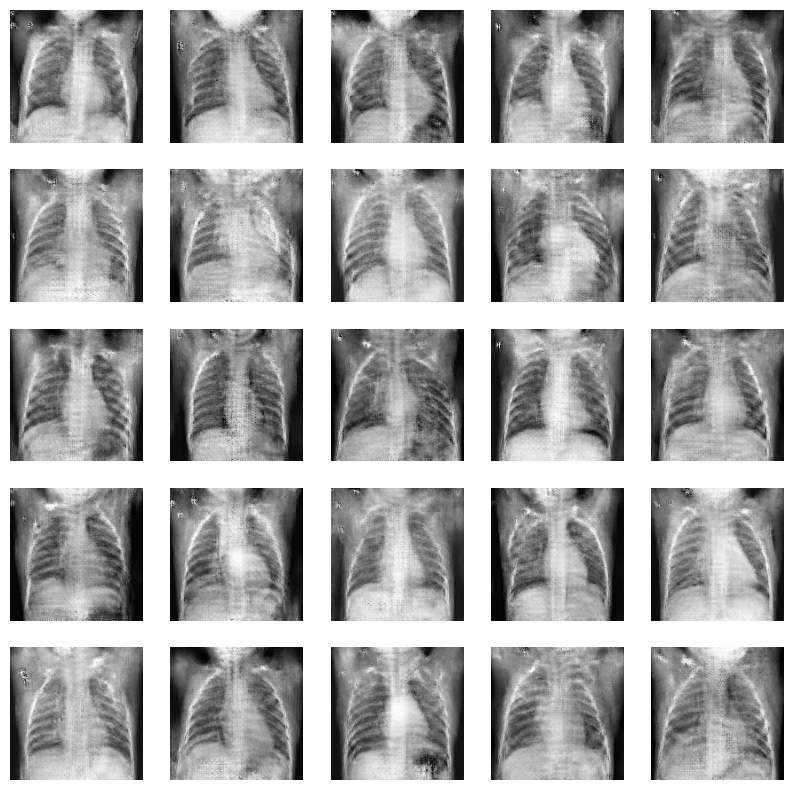

Epoch 121, Disc loss 0.2199404815910384, Generator loss 5.926601088047027
Epoch 122, Disc loss 0.21223578279896174, Generator loss 6.218782949447632
Epoch 123, Disc loss 0.1790743358884356, Generator loss 5.137633049488068
Epoch 124, Disc loss 0.1810776139725931, Generator loss 4.453727173805237
Epoch 125, Disc loss 0.18093903796980157, Generator loss 4.570094513893127
Epoch 126, Disc loss 0.17850912462454288, Generator loss 5.055545902252197
Epoch 127, Disc loss 0.18971383751922985, Generator loss 5.51695864200592
Epoch 128, Disc loss 0.19236663710325957, Generator loss 5.4808002471923825
Epoch 129, Disc loss 0.17902623771224171, Generator loss 5.546883296966553
Epoch 130, Disc loss 0.20442373929108726, Generator loss 6.282988047599792
1/1 [==============================] - 0s 19ms/step


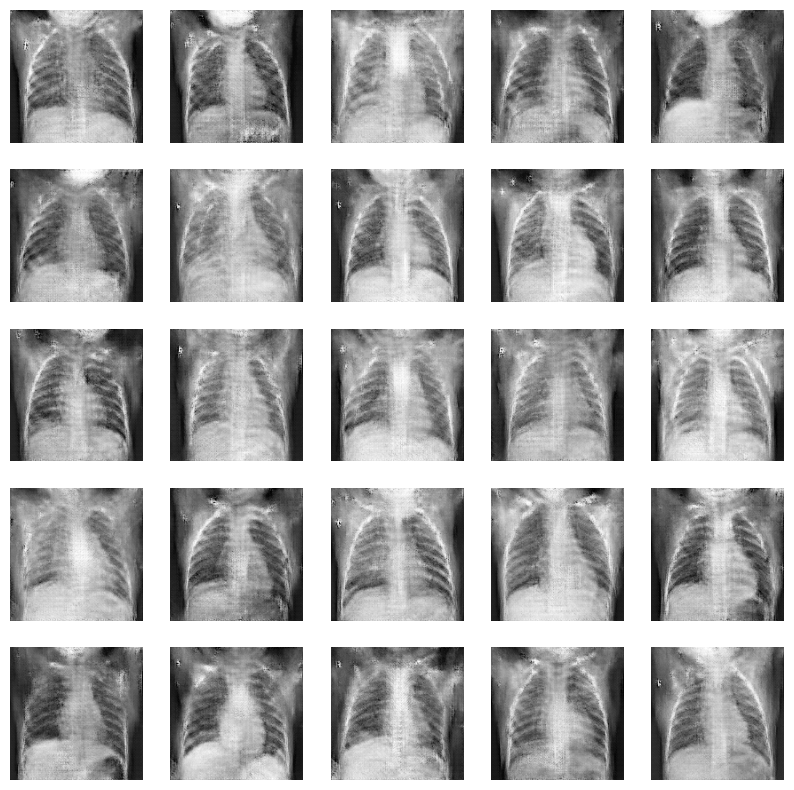

Epoch 131, Disc loss 0.24817042425493127, Generator loss 5.683339619636536
Epoch 132, Disc loss 0.18913949962006882, Generator loss 5.533083581924439
Epoch 133, Disc loss 0.18152207153616473, Generator loss 5.40784866809845
Epoch 134, Disc loss 0.1861062658834271, Generator loss 5.3264483451843265
Epoch 135, Disc loss 0.18870273731881754, Generator loss 5.411889636516571
Epoch 136, Disc loss 0.19548813538858667, Generator loss 5.3486324667930605
Epoch 137, Disc loss 0.18768190696137027, Generator loss 5.3377646684646605
Epoch 138, Disc loss 0.18678219874855131, Generator loss 5.288076233863831
Epoch 139, Disc loss 0.18229317923542113, Generator loss 4.6369976043701175
Epoch 140, Disc loss 0.17115851584239863, Generator loss 3.4497048020362855
1/1 [==============================] - 0s 30ms/step


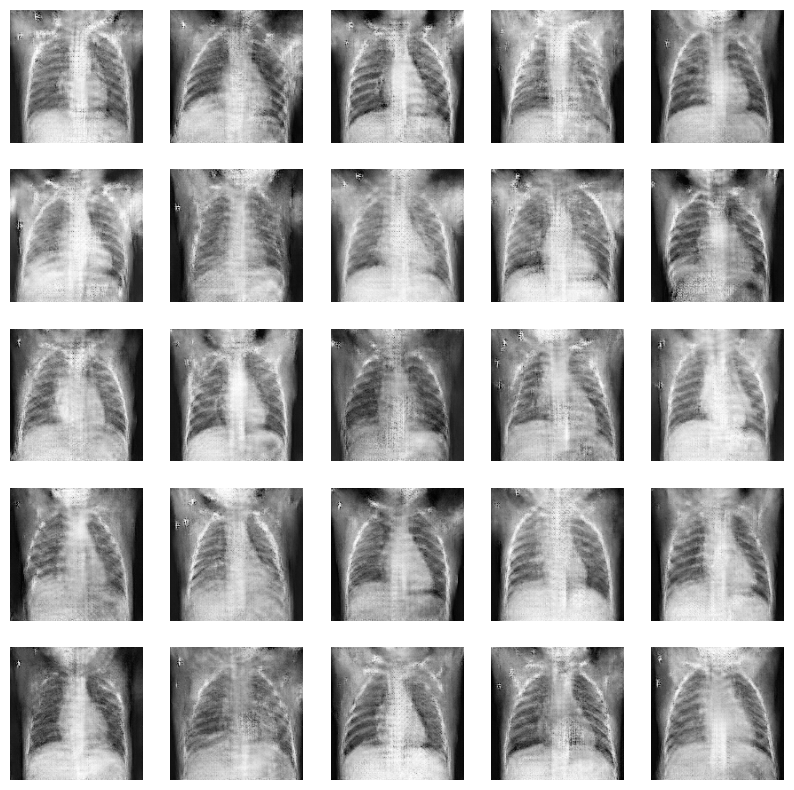

Epoch 141, Disc loss 0.17832588121527806, Generator loss 3.2580727458000185
Epoch 142, Disc loss 0.1878380427864613, Generator loss 3.3125502109527587
Epoch 143, Disc loss 1.3266251326735072, Generator loss 4.227637785673141
Epoch 144, Disc loss 0.336259915586561, Generator loss 2.4590606927871703
Epoch 145, Disc loss 0.3353995500132442, Generator loss 3.73353830575943
Epoch 146, Disc loss 0.30632562693208454, Generator loss 4.213162159919738
Epoch 147, Disc loss 0.2213929505785927, Generator loss 5.038105070590973
Epoch 148, Disc loss 0.20917730062501505, Generator loss 4.278339278697968
Epoch 149, Disc loss 0.21377057139907266, Generator loss 4.207239210605621
Epoch 150, Disc loss 0.19060891114640982, Generator loss 4.709131598472595
1/1 [==============================] - 0s 19ms/step


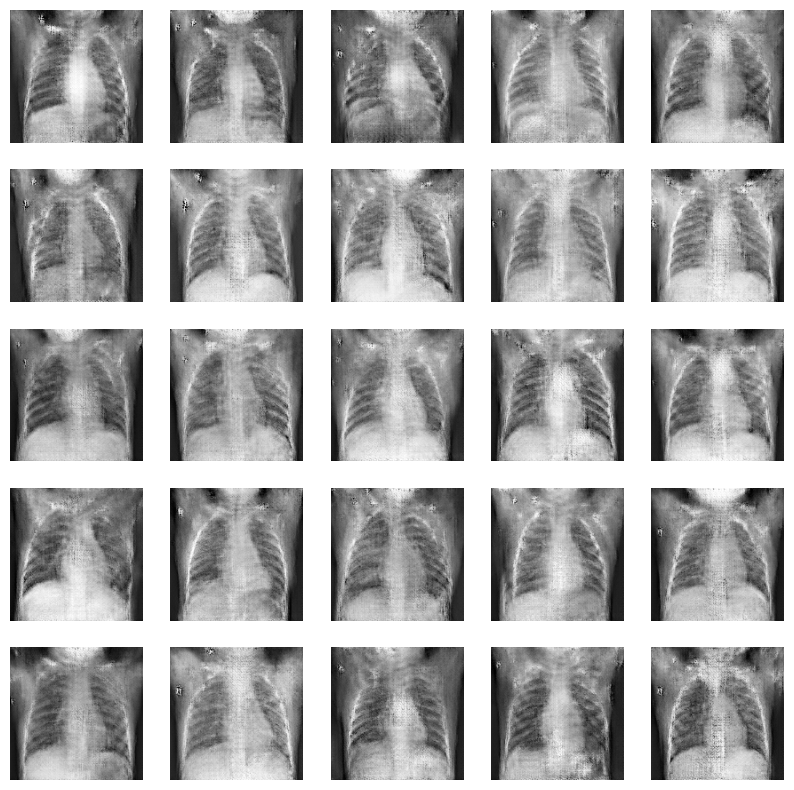

Epoch 151, Disc loss 0.19351224311394616, Generator loss 5.027799487113953
Epoch 152, Disc loss 0.1827202369167935, Generator loss 5.276327657699585
Epoch 153, Disc loss 0.19273748443229125, Generator loss 5.544063711166382
Epoch 154, Disc loss 0.19534294018521906, Generator loss 5.592183017730713
Epoch 155, Disc loss 0.1865113012958318, Generator loss 5.300151705741882
Epoch 156, Disc loss 0.18545928882667795, Generator loss 5.387423515319824
Epoch 157, Disc loss 0.1842126212781295, Generator loss 5.26026599407196
Epoch 158, Disc loss 0.1831659398274496, Generator loss 5.075067925453186
Epoch 159, Disc loss 0.18387385193491354, Generator loss 4.437447047233581
Epoch 160, Disc loss 0.1720094855874777, Generator loss 2.5725396156311033
1/1 [==============================] - 0s 18ms/step


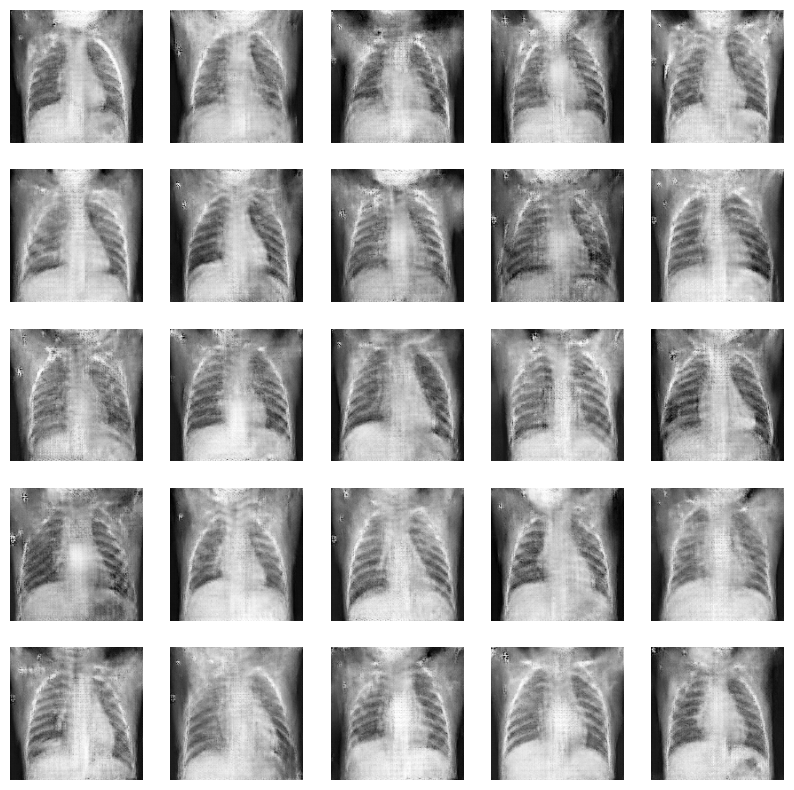

Epoch 161, Disc loss 0.1719213545904495, Generator loss 1.7353787153959275
Epoch 162, Disc loss 0.17146020694053732, Generator loss 2.209157419204712
Epoch 163, Disc loss 0.17057581995613874, Generator loss 0.8096512064337731
Epoch 164, Disc loss 0.2626360123656923, Generator loss 2.4379936784505842
Epoch 165, Disc loss 0.47664918227819725, Generator loss 2.406030225753784
Epoch 166, Disc loss 0.3129066279157996, Generator loss 2.2078682661056517
Epoch 167, Disc loss 0.3162840188480914, Generator loss 3.9000720620155334
Epoch 168, Disc loss 0.2505865117534995, Generator loss 5.1126191973686215
Epoch 169, Disc loss 0.22174815135076642, Generator loss 5.620103788375855
Epoch 170, Disc loss 0.2642482504248619, Generator loss 5.2602340340614315
1/1 [==============================] - 0s 30ms/step


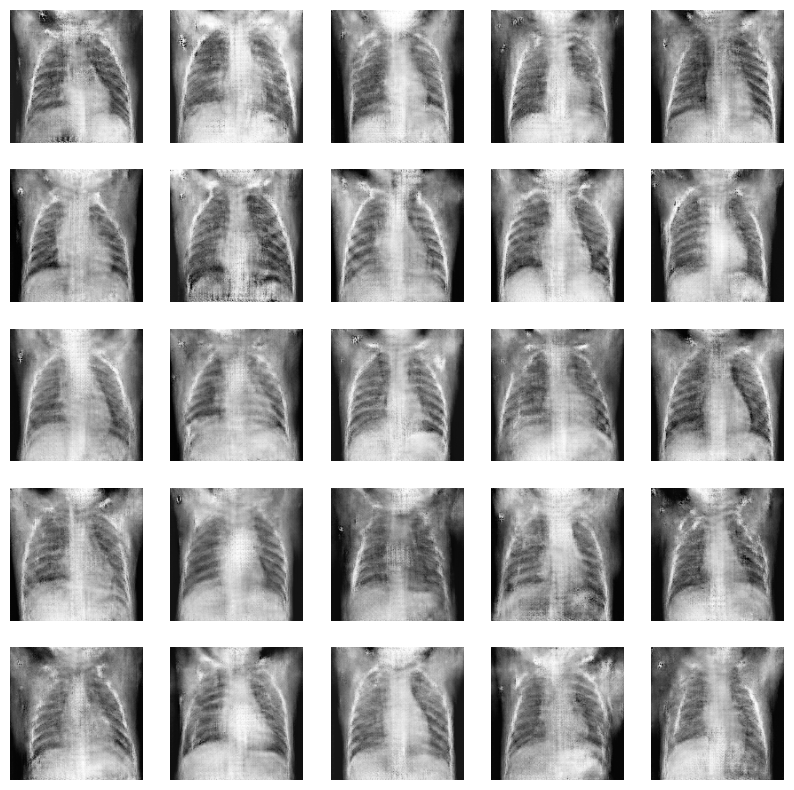

Epoch 171, Disc loss 0.2241564589436166, Generator loss 5.718601655960083
Epoch 172, Disc loss 0.2674410346837249, Generator loss 6.126053535938263
Epoch 173, Disc loss 0.1872816760907881, Generator loss 5.380919659137726
Epoch 174, Disc loss 0.18321028565987946, Generator loss 4.048510599136352
Epoch 175, Disc loss 0.18897959486930632, Generator loss 4.293017208576202
Epoch 176, Disc loss 0.18095260972040705, Generator loss 4.589047288894653
Epoch 177, Disc loss 0.18016946409479714, Generator loss 4.902436041831971
Epoch 178, Disc loss 0.1805414371949155, Generator loss 5.280858588218689
Epoch 179, Disc loss 0.17930253330268897, Generator loss 5.5821715831756595
Epoch 180, Disc loss 0.18140173956053332, Generator loss 5.5386947870254515
1/1 [==============================] - 0s 20ms/step


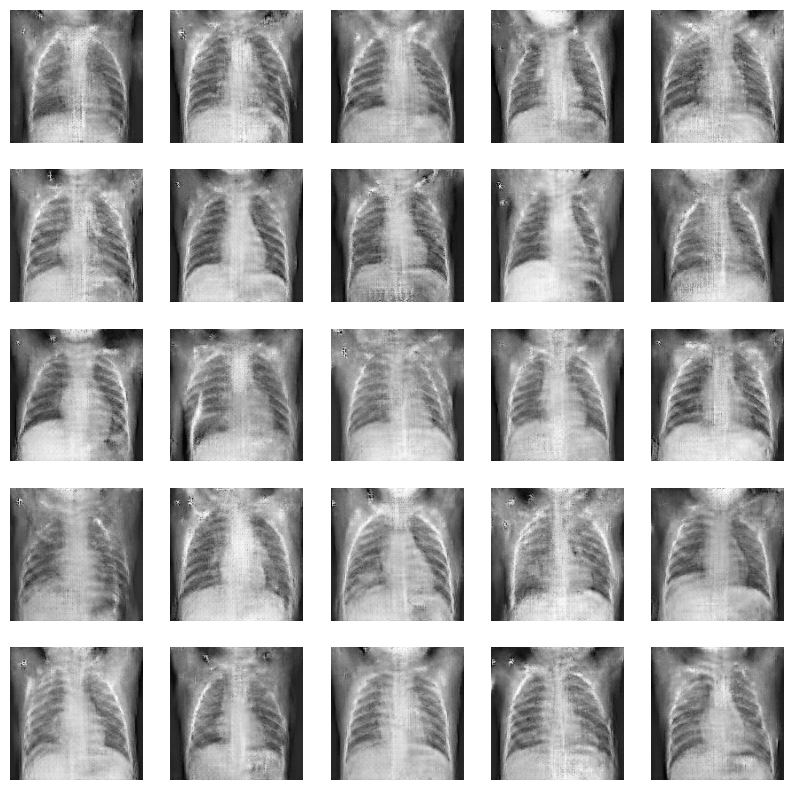

Epoch 181, Disc loss 0.17901814117794856, Generator loss 5.61209192276001
Epoch 182, Disc loss 0.1846409398713149, Generator loss 5.431370973587036
Epoch 183, Disc loss 0.17789536432246678, Generator loss 5.730297112464905
Epoch 184, Disc loss 0.1791589052299969, Generator loss 5.41460223197937
Epoch 185, Disc loss 0.18118826006539165, Generator loss 5.3844574928283695
Epoch 186, Disc loss 0.18348903151927515, Generator loss 5.210469746589661
Epoch 187, Disc loss 0.17671304541872815, Generator loss 5.081808531284333
Epoch 188, Disc loss 0.17167068126727827, Generator loss 4.164938843250274
Epoch 189, Disc loss 0.17375333295203746, Generator loss 3.7166698575019836
Epoch 190, Disc loss 0.16825343620730565, Generator loss 3.322128188610077
1/1 [==============================] - 0s 35ms/step


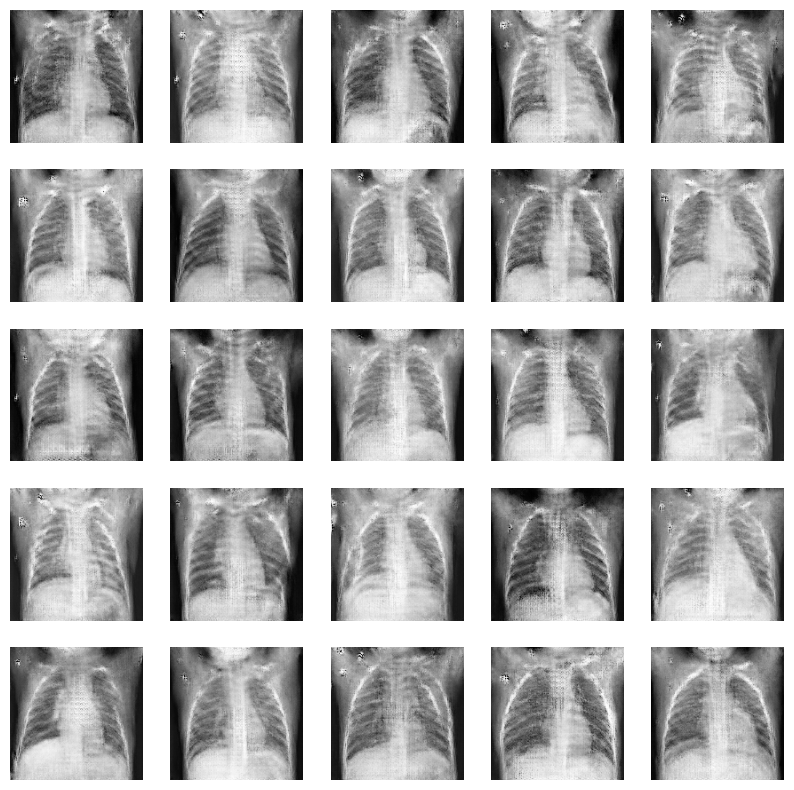

Epoch 191, Disc loss 0.1704804636159679, Generator loss 1.9627023190259933
Epoch 192, Disc loss 0.18240627818158828, Generator loss 2.6379680693149568
Epoch 193, Disc loss 0.2915032518343651, Generator loss 4.545277461409569
Epoch 194, Disc loss 0.33774746004492046, Generator loss 1.5996091157197951
Epoch 195, Disc loss 0.271554328489583, Generator loss 2.3441027760505677
Epoch 196, Disc loss 0.28600320711266247, Generator loss 4.775738382339478
Epoch 197, Disc loss 0.19224922887515278, Generator loss 5.517659211158753
Epoch 198, Disc loss 0.19709064244525507, Generator loss 5.325237774848938
Epoch 199, Disc loss 0.19379096404300072, Generator loss 5.463994145393372
Epoch 200, Disc loss 0.21703716927440836, Generator loss 5.839913415908813
1/1 [==============================] - 0s 24ms/step


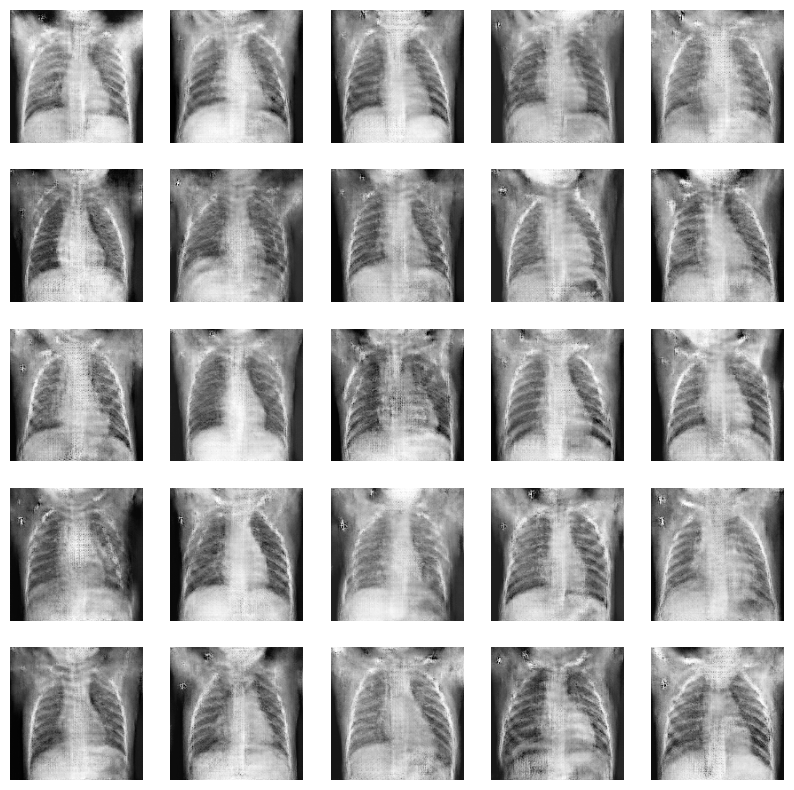

Epoch 201, Disc loss 0.18588201612001284, Generator loss 6.124747610092163
Epoch 202, Disc loss 0.1949935294338502, Generator loss 5.8161486148834225
Epoch 203, Disc loss 0.1913496409833897, Generator loss 6.184855914115905
Epoch 204, Disc loss 0.22674067376647145, Generator loss 5.7898784399032595
Epoch 205, Disc loss 0.19057516334578395, Generator loss 5.932440960407257
Epoch 206, Disc loss 0.2107097097206861, Generator loss 5.661626315116882
Epoch 207, Disc loss 0.1908113488170784, Generator loss 5.80484824180603
Epoch 208, Disc loss 0.24559691002359613, Generator loss 5.703250372409821
Epoch 209, Disc loss 0.24940694753313436, Generator loss 6.059006595611573
Epoch 210, Disc loss 0.2094087932317052, Generator loss 5.981117486953735
1/1 [==============================] - 0s 28ms/step


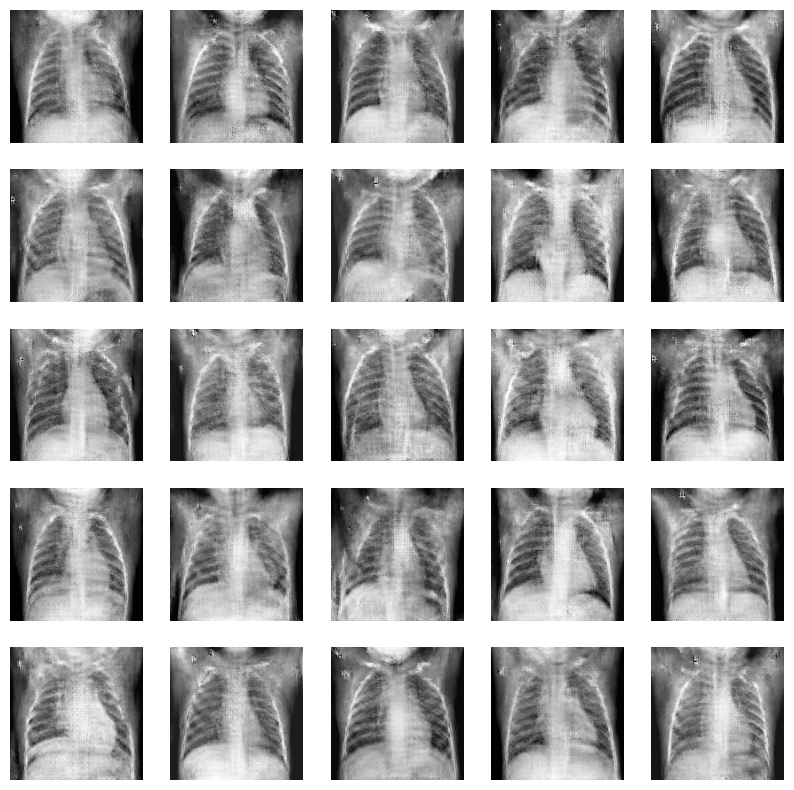

Epoch 211, Disc loss 0.2550205371226184, Generator loss 6.149615097045898
Epoch 212, Disc loss 0.2234544998849742, Generator loss 6.08722288608551
Epoch 213, Disc loss 0.18133091789204628, Generator loss 6.161576175689698
Epoch 214, Disc loss 0.19457751169684342, Generator loss 7.049116420745849
Epoch 215, Disc loss 0.21026652137516066, Generator loss 6.509966802597046
Epoch 216, Disc loss 0.21785540571436285, Generator loss 6.397843885421753
Epoch 217, Disc loss 0.19836340011679568, Generator loss 6.439450120925903
Epoch 218, Disc loss 0.21984376184409485, Generator loss 6.481801772117615
Epoch 219, Disc loss 0.1806543615704868, Generator loss 6.468277072906494
Epoch 220, Disc loss 0.16959756353008118, Generator loss 6.719865393638611
1/1 [==============================] - 0s 20ms/step


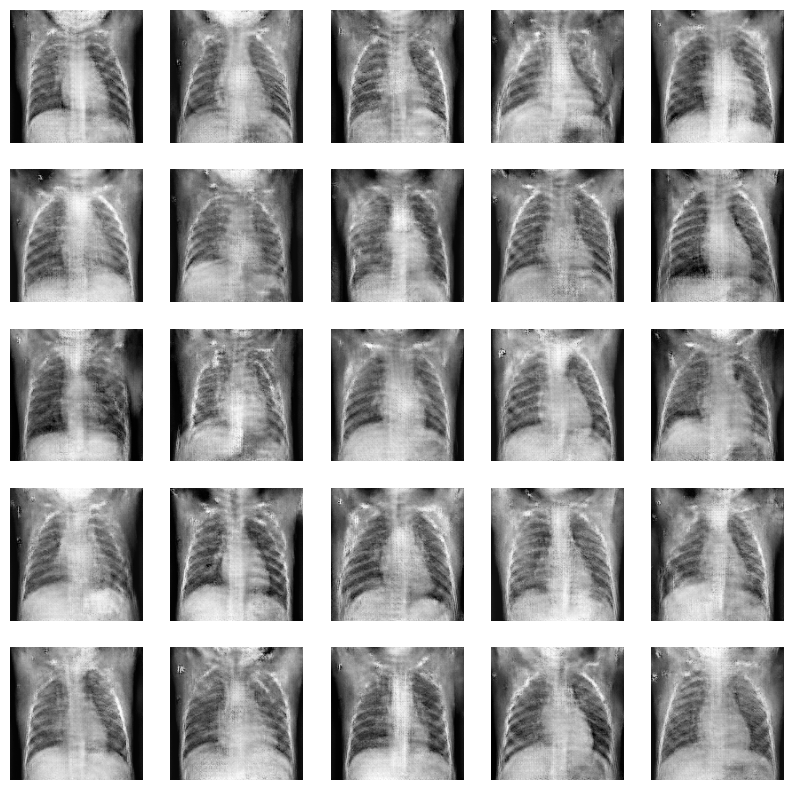

Epoch 221, Disc loss 0.1710986101301387, Generator loss 5.322968745231629
Epoch 222, Disc loss 0.18314243807981256, Generator loss 5.728820395469666
Epoch 223, Disc loss 0.19834501533186993, Generator loss 5.914239668846131
Epoch 224, Disc loss 0.1830783829485881, Generator loss 6.191022658348084
Epoch 225, Disc loss 0.2148342237866018, Generator loss 6.110812568664551
Epoch 226, Disc loss 0.188834334659623, Generator loss 5.881765627861023
Epoch 227, Disc loss 0.1930867041926831, Generator loss 6.28566654920578
Epoch 228, Disc loss 0.17913943939493038, Generator loss 6.544668769836425
Epoch 229, Disc loss 0.20433331697713583, Generator loss 6.169478058815002
Epoch 230, Disc loss 0.29132118805428037, Generator loss 5.685076403617859
1/1 [==============================] - 0s 21ms/step


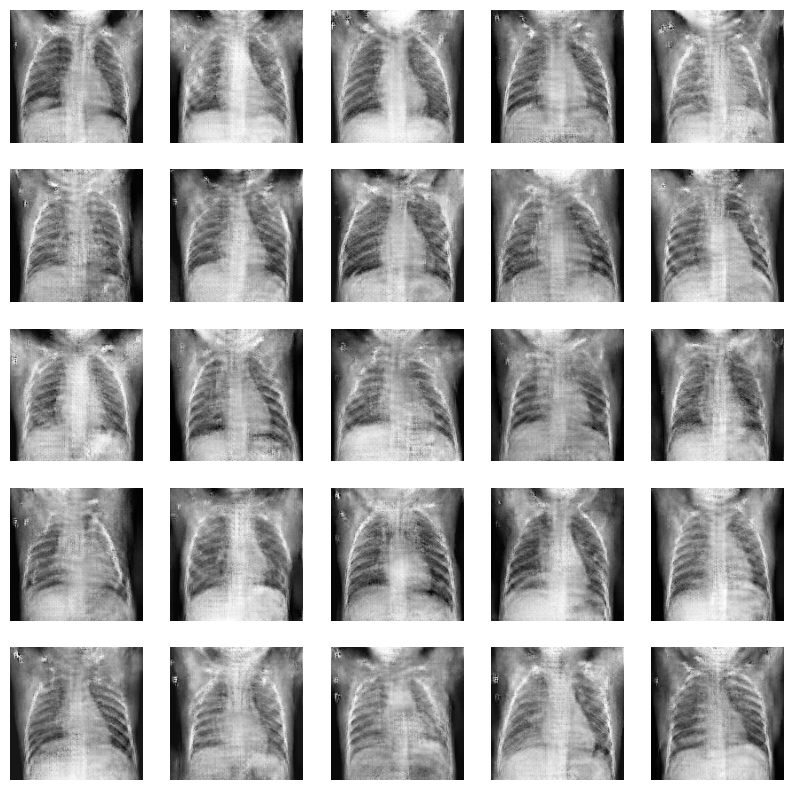

Epoch 231, Disc loss 0.20217069656355308, Generator loss 6.172518563270569
Epoch 232, Disc loss 0.19820327566703783, Generator loss 6.0168535828590395
Epoch 233, Disc loss 0.2096193110453896, Generator loss 6.0899639368057255
Epoch 234, Disc loss 0.27104220185428857, Generator loss 6.747861361503601
Epoch 235, Disc loss 0.2020537877222523, Generator loss 6.328467845916748
Epoch 236, Disc loss 0.20391237502917647, Generator loss 6.255798625946045
Epoch 237, Disc loss 0.19579366750549526, Generator loss 6.352023875713348
Epoch 238, Disc loss 0.19537833839422092, Generator loss 6.450440692901611
Epoch 239, Disc loss 0.2775966567220166, Generator loss 6.716001391410828
Epoch 240, Disc loss 0.6521306412294507, Generator loss 4.846178579330444
1/1 [==============================] - 0s 42ms/step


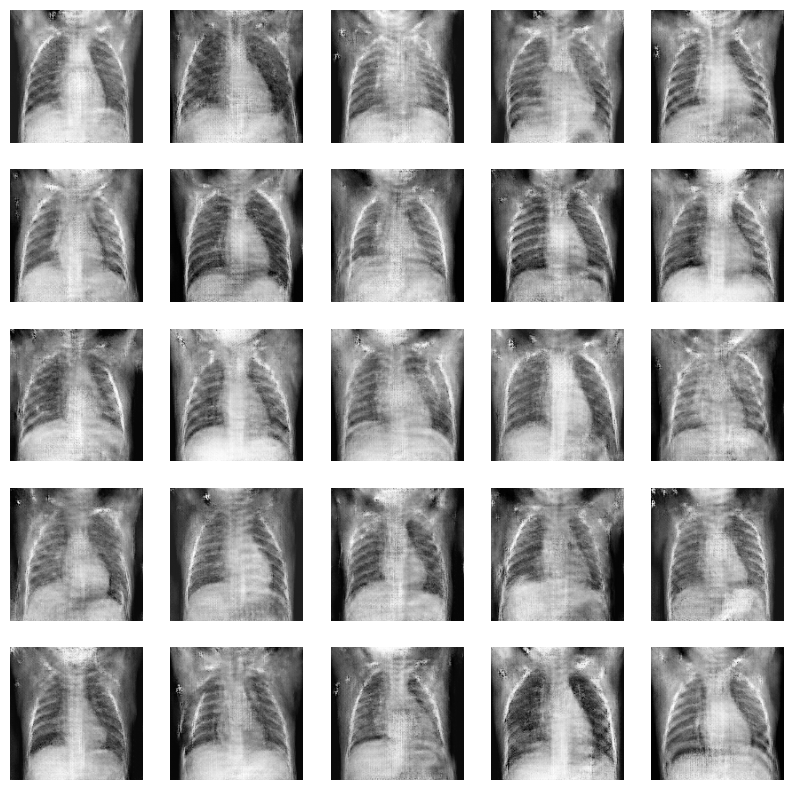

Epoch 241, Disc loss 0.2372309536440298, Generator loss 5.900811171531677
Epoch 242, Disc loss 0.18220465935301036, Generator loss 4.8795130252838135
Epoch 243, Disc loss 0.18711588522419334, Generator loss 4.472680246829986
Epoch 244, Disc loss 0.17976155714131892, Generator loss 4.806783604621887
Epoch 245, Disc loss 0.18593475919333285, Generator loss 5.247587513923645
Epoch 246, Disc loss 0.18033154563745485, Generator loss 5.445480799674987
Epoch 247, Disc loss 0.18305208655656316, Generator loss 5.50820484161377
Epoch 248, Disc loss 0.17732919116970153, Generator loss 5.892575407028199
Epoch 249, Disc loss 0.18323749779956416, Generator loss 6.101094794273377
Epoch 250, Disc loss 0.17830138554563746, Generator loss 6.016504502296447
1/1 [==============================] - 0s 19ms/step


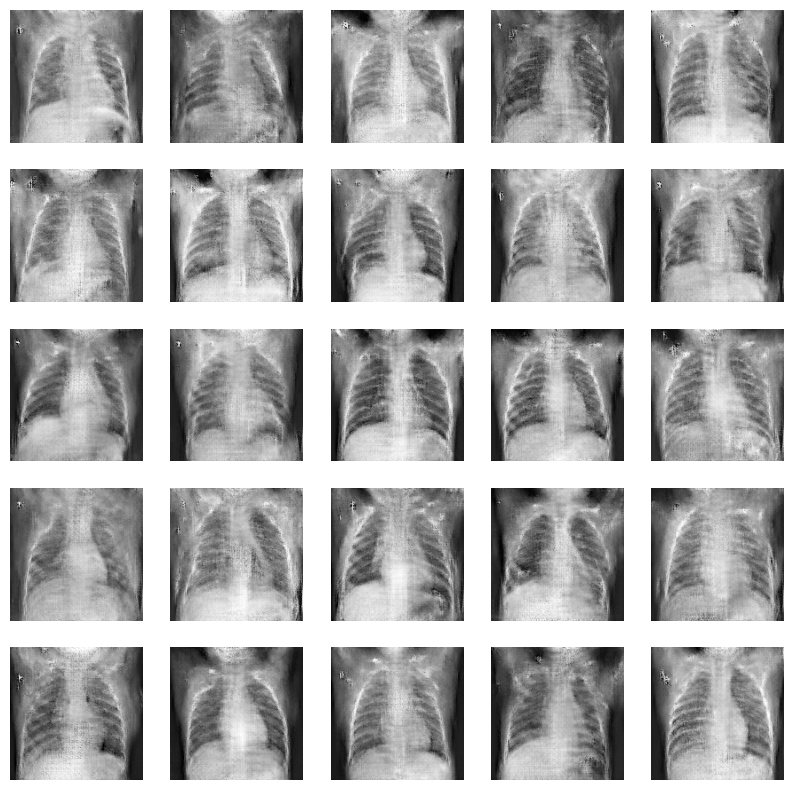

Epoch 251, Disc loss 0.17934239627211354, Generator loss 6.022578430175781
Epoch 252, Disc loss 0.1815416736062616, Generator loss 5.9415301322937015
Epoch 253, Disc loss 0.17881261320435443, Generator loss 5.8556108474731445
Epoch 254, Disc loss 0.1780545370769687, Generator loss 5.915415668487549
Epoch 255, Disc loss 0.18127052488271148, Generator loss 5.876157355308533
Epoch 256, Disc loss 0.17639952551107854, Generator loss 5.987056803703308
Epoch 257, Disc loss 0.18495473915245383, Generator loss 5.886184215545654
Epoch 258, Disc loss 0.17769249488483183, Generator loss 5.973986053466797
Epoch 259, Disc loss 0.18369456769432874, Generator loss 5.879911875724792
Epoch 260, Disc loss 0.18494806707603856, Generator loss 5.6660364151000975
1/1 [==============================] - 0s 18ms/step


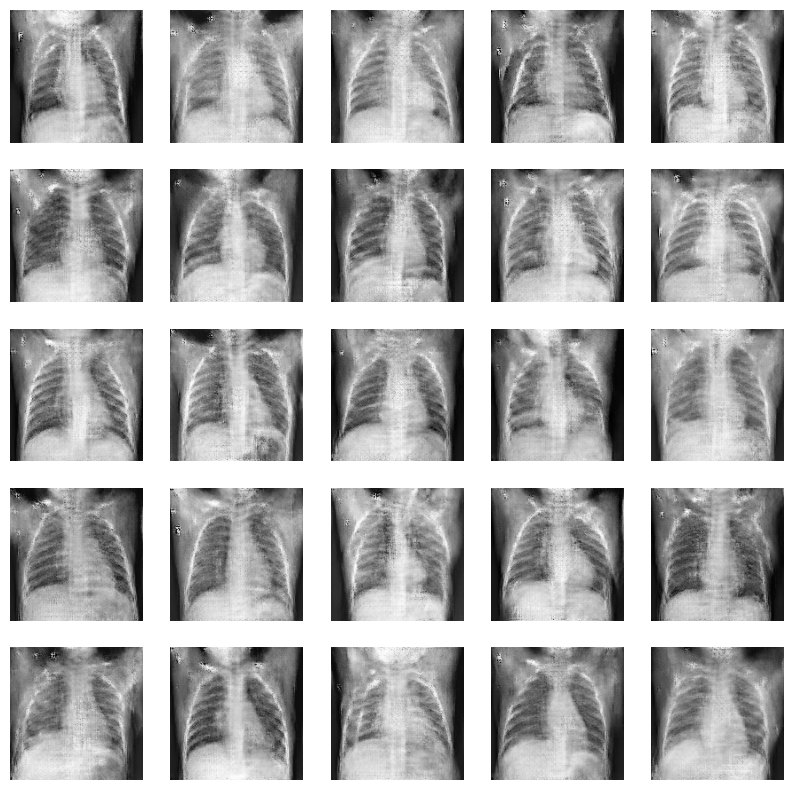

Epoch 261, Disc loss 0.1776024436345324, Generator loss 5.466748285293579
Epoch 262, Disc loss 0.17651048132684083, Generator loss 4.908547306060791
Epoch 263, Disc loss 0.17726596351712942, Generator loss 4.760471570491791
Epoch 264, Disc loss 0.17840385535382666, Generator loss 4.707098972797394
Epoch 265, Disc loss 0.18348977156274487, Generator loss 5.0107305407524105
Epoch 266, Disc loss 0.18249501234968193, Generator loss 5.141389429569244
Epoch 267, Disc loss 0.178943470082595, Generator loss 5.3135068893432615
Epoch 268, Disc loss 0.17552662621310447, Generator loss 4.937076604366302
Epoch 269, Disc loss 0.1732604793694918, Generator loss 4.605194830894471
Epoch 270, Disc loss 0.3416050688480027, Generator loss 3.3107241690158844
1/1 [==============================] - 0s 36ms/step


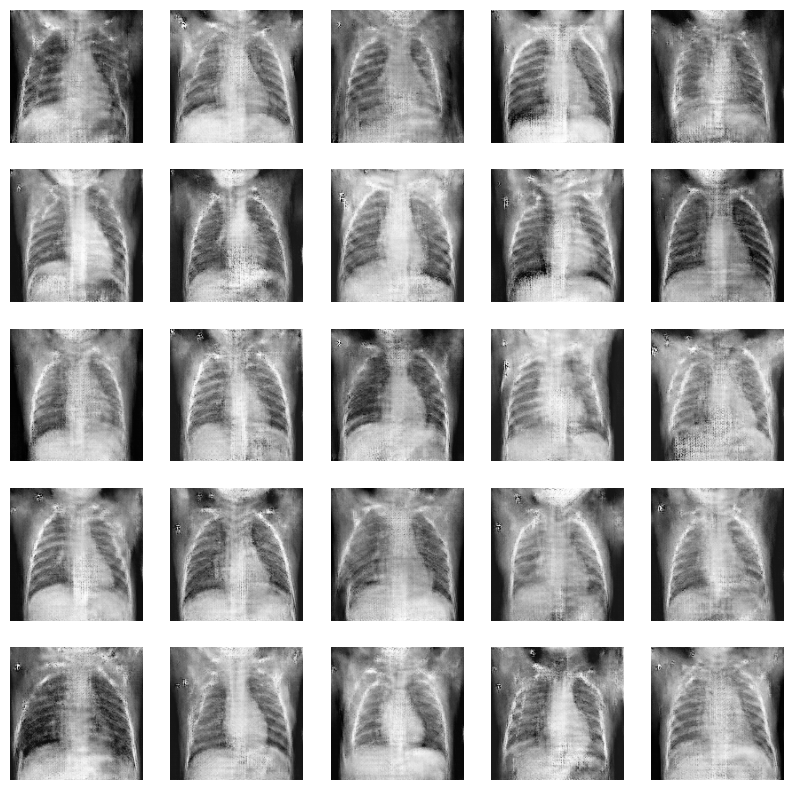

Epoch 271, Disc loss 0.21423692362732255, Generator loss 5.61093784570694
Epoch 272, Disc loss 0.18433189532661345, Generator loss 7.047734951972961
Epoch 273, Disc loss 0.21876226362073795, Generator loss 6.830202317237854
Epoch 274, Disc loss 0.22052758182690013, Generator loss 7.0960111856460575
Epoch 275, Disc loss 0.17562024781364016, Generator loss 6.510199761390686
Epoch 276, Disc loss 0.2110072097275406, Generator loss 6.143110871315002
Epoch 277, Disc loss 0.18972927821450866, Generator loss 6.307365918159485
Epoch 278, Disc loss 0.18107767321052962, Generator loss 6.4901642322540285
Epoch 279, Disc loss 0.20331462285284943, Generator loss 6.797177934646607
Epoch 280, Disc loss 0.1881918326485902, Generator loss 6.26345727443695
1/1 [==============================] - 0s 19ms/step


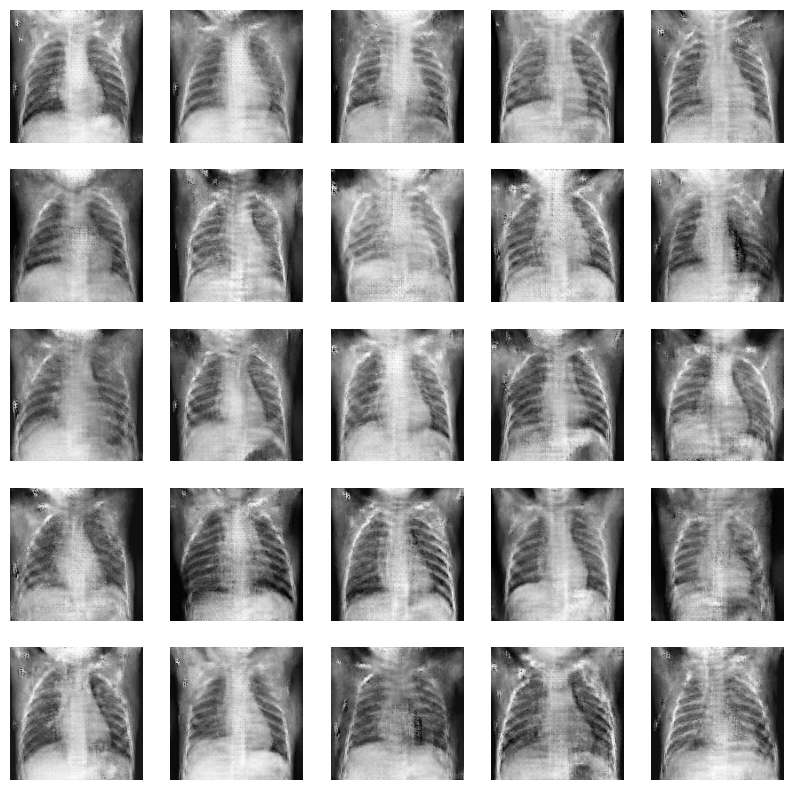

Epoch 281, Disc loss 0.2877695209346712, Generator loss 5.9564718246459964
Epoch 282, Disc loss 0.21425903256749734, Generator loss 6.085350131988525
Epoch 283, Disc loss 0.18314723236253486, Generator loss 6.444813847541809
Epoch 284, Disc loss 0.18478476290474646, Generator loss 6.185348868370056
Epoch 285, Disc loss 0.193243303487543, Generator loss 6.364952802658081
Epoch 286, Disc loss 0.1881049040799553, Generator loss 7.420416760444641
Epoch 287, Disc loss 0.23920625906903298, Generator loss 6.096690011024475
Epoch 288, Disc loss 0.19569734642282127, Generator loss 6.6467996597290036
Epoch 289, Disc loss 0.18115994447725825, Generator loss 6.487743473052978
Epoch 290, Disc loss 0.28852313505776694, Generator loss 6.609347915649414
1/1 [==============================] - 0s 21ms/step


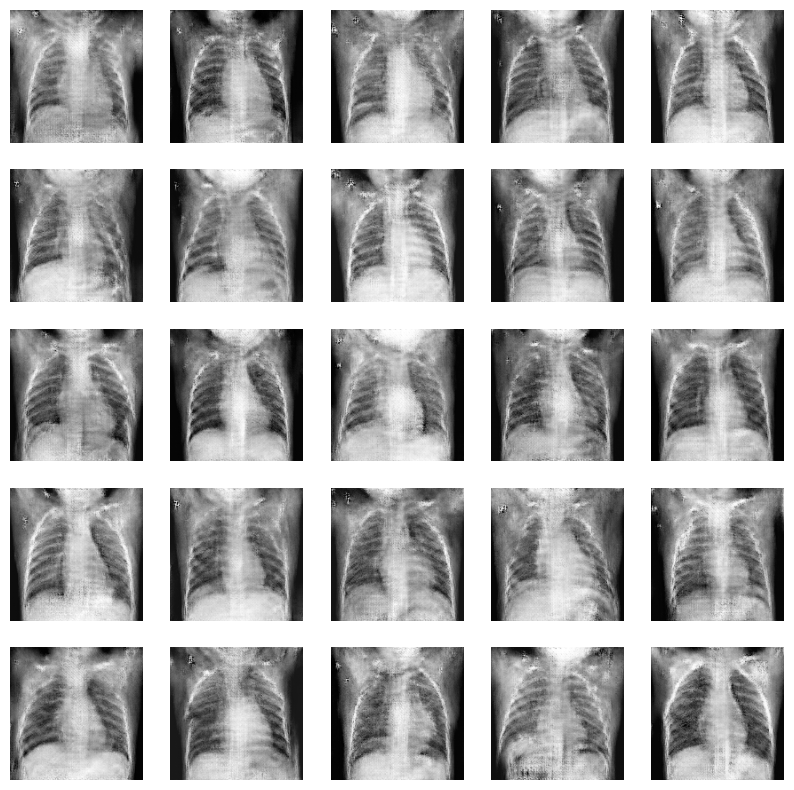

Epoch 291, Disc loss 0.1874388341219401, Generator loss 8.23664333820343
Epoch 292, Disc loss 0.2650647181988461, Generator loss 6.592988920211792
Epoch 293, Disc loss 0.18502433093963191, Generator loss 6.462690758705139
Epoch 294, Disc loss 0.1830054369464051, Generator loss 6.8746641874313354
Epoch 295, Disc loss 0.19659500643610955, Generator loss 6.954673147201538
Epoch 296, Disc loss 0.1940182862279471, Generator loss 5.9385846018791195
Epoch 297, Disc loss 0.17613135753636017, Generator loss 8.186638164520264
Epoch 298, Disc loss 0.16739014677295927, Generator loss 6.4321800708770756
Epoch 299, Disc loss 0.17228996912599542, Generator loss 5.326334631443023
Epoch 300, Disc loss 0.1723456305509899, Generator loss 5.511624884605408
1/1 [==============================] - 0s 19ms/step


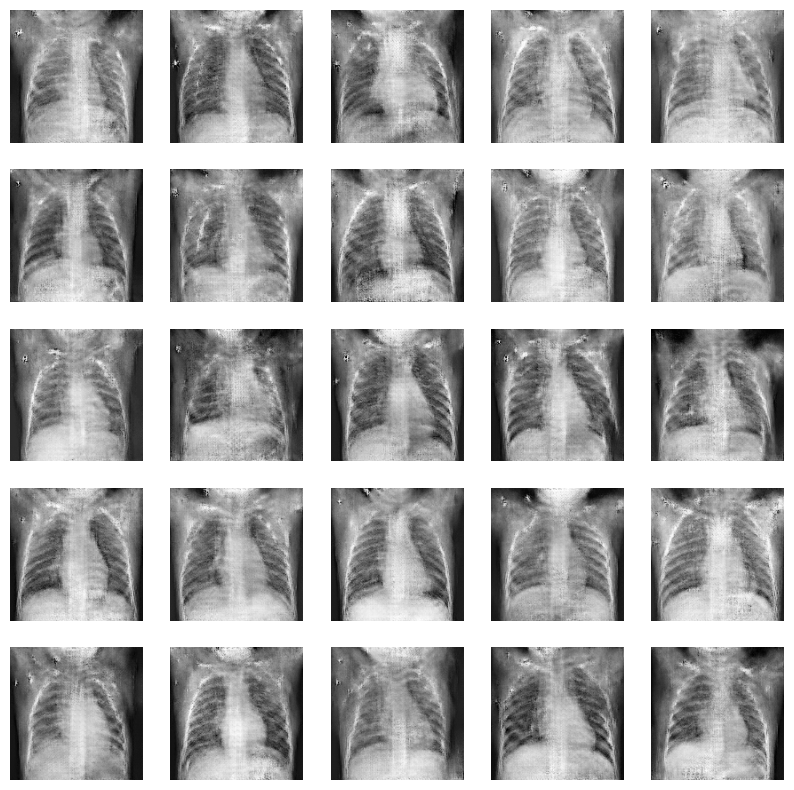

Epoch 301, Disc loss 0.17711224685772323, Generator loss 5.696899676322937
Epoch 302, Disc loss 0.17346338360657682, Generator loss 6.054421424865723
Epoch 303, Disc loss 0.180269772587053, Generator loss 6.277052736282348
Epoch 304, Disc loss 0.1737383679836057, Generator loss 6.201345634460449
Epoch 305, Disc loss 0.1753575377399102, Generator loss 6.262402844429016
Epoch 306, Disc loss 0.17566262530745008, Generator loss 6.312065505981446
Epoch 307, Disc loss 0.17073649326921442, Generator loss 6.649837970733643
Epoch 308, Disc loss 0.17837247705028858, Generator loss 6.29695451259613
Epoch 309, Disc loss 0.17310250691953116, Generator loss 6.644098234176636
Epoch 310, Disc loss 0.18029278519388753, Generator loss 6.34978334903717
1/1 [==============================] - 0s 47ms/step


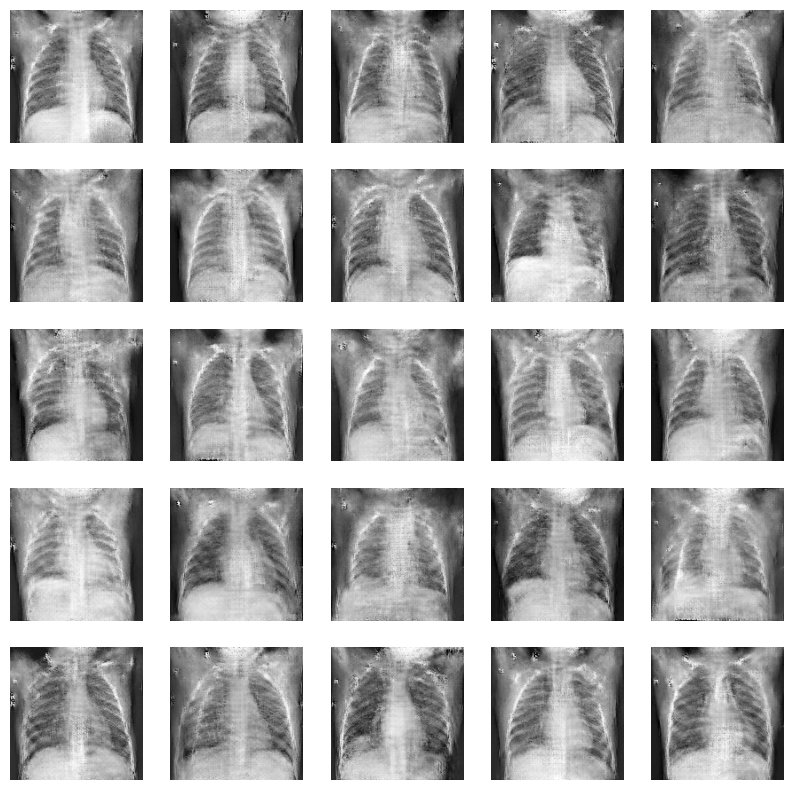

Epoch 311, Disc loss 0.1746301741717616, Generator loss 6.410609149932862
Epoch 312, Disc loss 0.17438855610089377, Generator loss 6.571972155570984
Epoch 313, Disc loss 0.1775575092586223, Generator loss 6.709040427207947
Epoch 314, Disc loss 0.17979352855472824, Generator loss 6.40390899181366
Epoch 315, Disc loss 0.18270986347924917, Generator loss 6.367202806472778
Epoch 316, Disc loss 0.18921026585740036, Generator loss 6.368597316741943
Epoch 317, Disc loss 0.17754895738908089, Generator loss 6.305820798873901
Epoch 318, Disc loss 0.1749847938772291, Generator loss 6.287021923065185
Epoch 319, Disc loss 0.18221167342271655, Generator loss 6.199954652786255
Epoch 320, Disc loss 0.17709106246475131, Generator loss 6.114754915237427
1/1 [==============================] - 0s 29ms/step


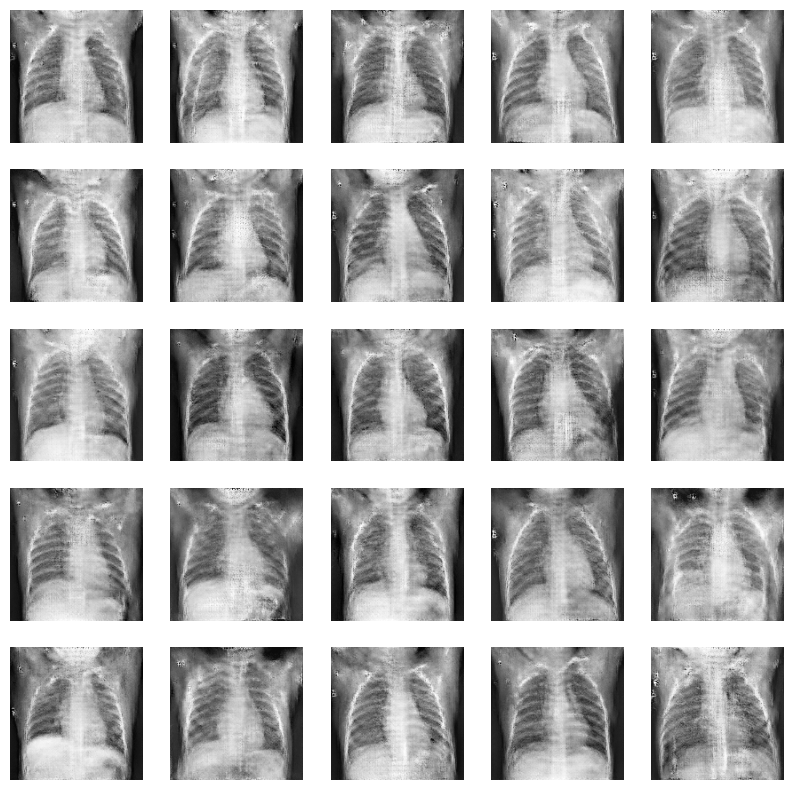

Epoch 321, Disc loss 0.17718299378757366, Generator loss 5.991214680671692
Epoch 322, Disc loss 0.17755396558786743, Generator loss 5.3272045969963076
Epoch 323, Disc loss 0.17055377177603076, Generator loss 3.911815011501312
Epoch 324, Disc loss 0.1810719242785126, Generator loss 3.660471719503403
Epoch 325, Disc loss 0.19773195690941064, Generator loss 3.1686625361442564
Epoch 326, Disc loss 0.21125455146247987, Generator loss 6.991397523880005
Epoch 327, Disc loss 0.20682391984737478, Generator loss 6.622600507736206
Epoch 328, Disc loss 1.8795148314602557, Generator loss 8.132900202274323
Epoch 329, Disc loss 1.3548371013253928, Generator loss 4.248229992389679
Epoch 330, Disc loss 0.4270165912806988, Generator loss 3.436578357219696
1/1 [==============================] - 0s 18ms/step


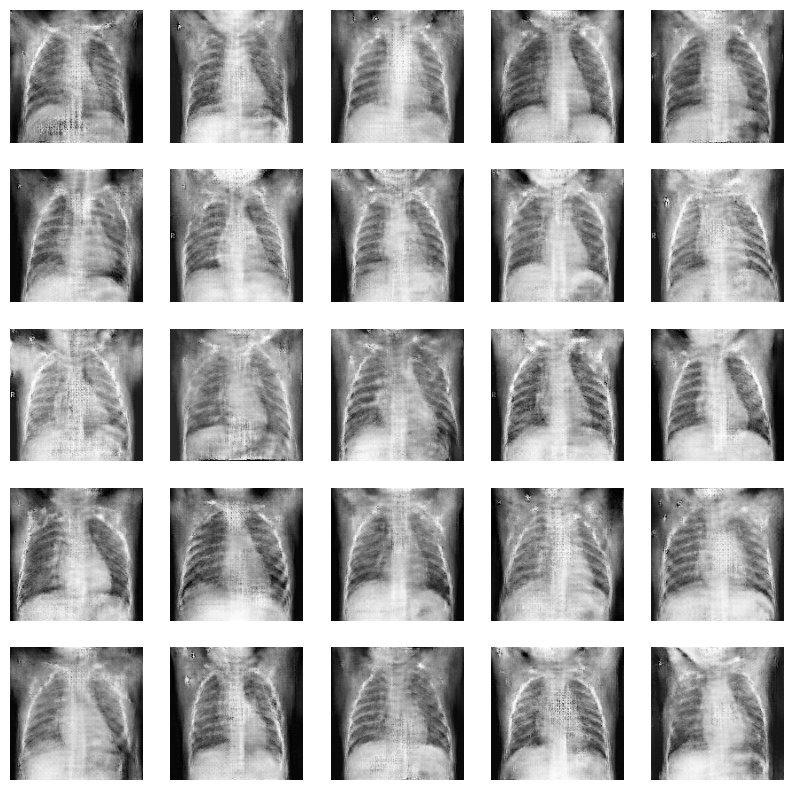

Epoch 331, Disc loss 0.382021501287818, Generator loss 4.378783249855042
Epoch 332, Disc loss 0.31084421239793303, Generator loss 5.050669622421265
Epoch 333, Disc loss 0.2830881304573268, Generator loss 5.652846384048462
Epoch 334, Disc loss 0.3285673758946359, Generator loss 4.492220723628998
Epoch 335, Disc loss 0.26188551662489773, Generator loss 5.374468588829041
Epoch 336, Disc loss 0.2730597725370899, Generator loss 5.454674625396729
Epoch 337, Disc loss 0.2660482469946146, Generator loss 5.333883547782898
Epoch 338, Disc loss 0.2630862366873771, Generator loss 5.263106417655945
Epoch 339, Disc loss 0.24297575913369657, Generator loss 5.795991921424866
Epoch 340, Disc loss 0.27482397044077517, Generator loss 5.147921895980835
1/1 [==============================] - 0s 32ms/step


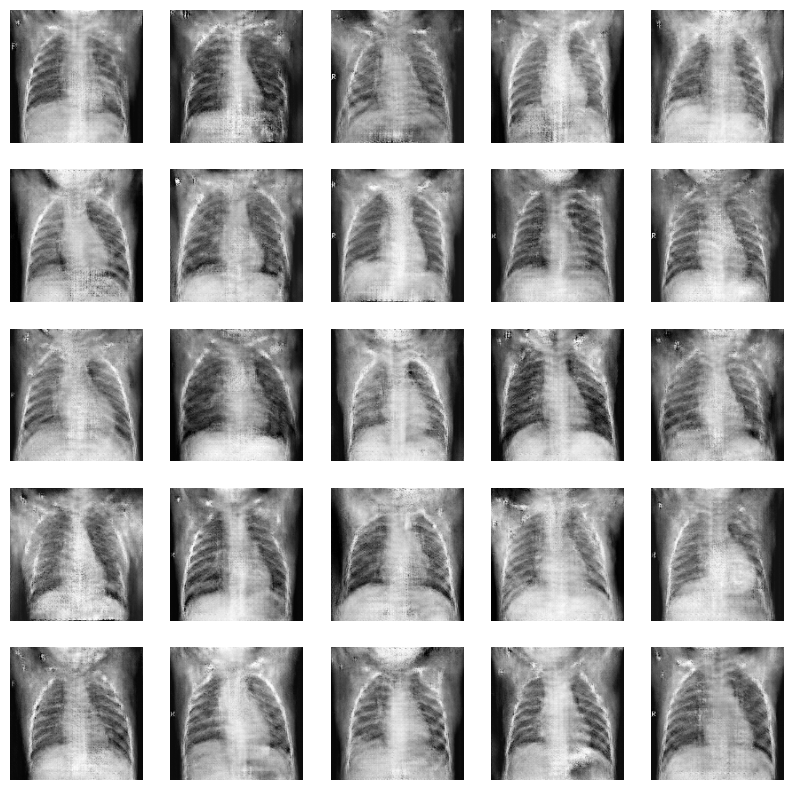

Epoch 341, Disc loss 0.2446297806687653, Generator loss 5.543974542617798
Epoch 342, Disc loss 0.2568534965626895, Generator loss 5.5473157405853275
Epoch 343, Disc loss 0.25715179834514856, Generator loss 5.352336585521698
Epoch 344, Disc loss 0.23718360997736454, Generator loss 5.598971652984619
Epoch 345, Disc loss 0.22909689317457377, Generator loss 5.964942812919617
Epoch 346, Disc loss 0.22949542300775647, Generator loss 5.793917346000671
Epoch 347, Disc loss 0.233985433075577, Generator loss 5.470409822463989
Epoch 348, Disc loss 0.23275045123882593, Generator loss 5.474590110778808
Epoch 349, Disc loss 0.2781021194299683, Generator loss 6.109313869476319
Epoch 350, Disc loss 0.19373171322513372, Generator loss 5.724500775337219
1/1 [==============================] - 0s 19ms/step


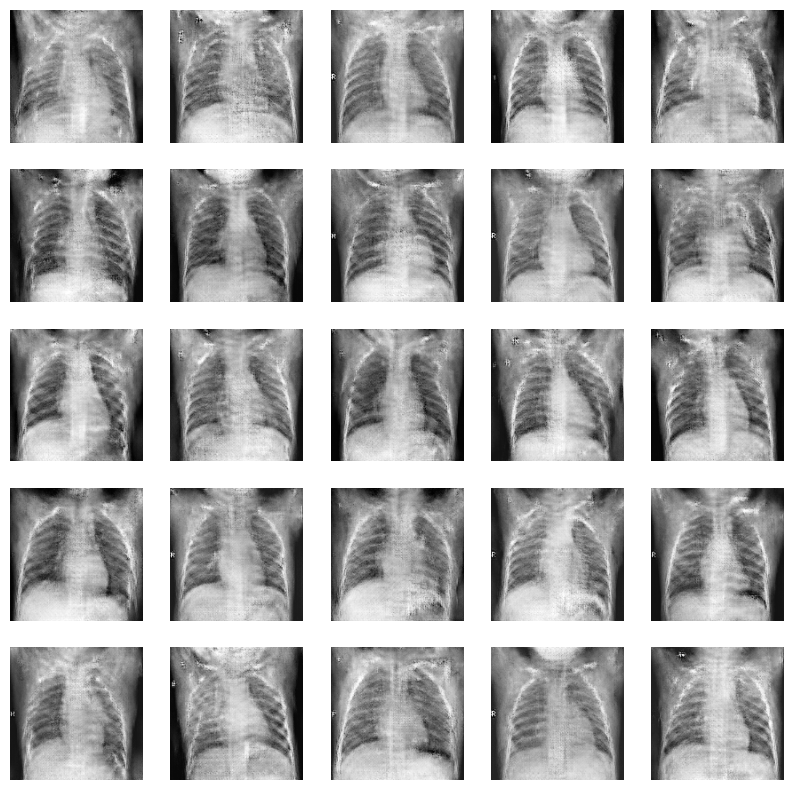

Epoch 351, Disc loss 0.25403565522283317, Generator loss 5.428601884841919
Epoch 352, Disc loss 0.23446352244354784, Generator loss 5.484254801273346
Epoch 353, Disc loss 0.24858794836327433, Generator loss 5.812942576408386
Epoch 354, Disc loss 0.23111430201679467, Generator loss 6.57001268863678
Epoch 355, Disc loss 0.23076688529945386, Generator loss 5.963118267059326
Epoch 356, Disc loss 0.20003954957937822, Generator loss 6.2814325332641605
Epoch 357, Disc loss 0.21944535879883914, Generator loss 5.878359436988831
Epoch 358, Disc loss 0.2662982929032296, Generator loss 5.786722230911255
Epoch 359, Disc loss 0.21296064842608758, Generator loss 5.936507320404052
Epoch 360, Disc loss 0.23390682375757024, Generator loss 5.9266784429550174
1/1 [==============================] - 0s 21ms/step


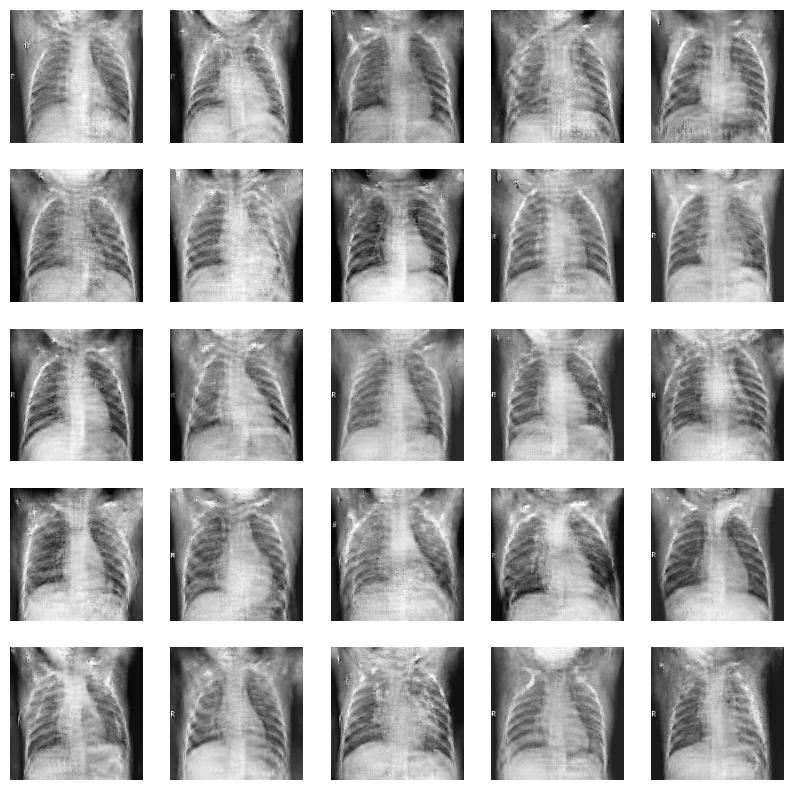

Epoch 361, Disc loss 0.23508357455721124, Generator loss 6.221898484230041
Epoch 362, Disc loss 0.17372091544384602, Generator loss 5.801431202888489
Epoch 363, Disc loss 0.1760767155617941, Generator loss 5.386435604095459
Epoch 364, Disc loss 0.1816857370402431, Generator loss 5.223503291606903
Epoch 365, Disc loss 0.1823063641320914, Generator loss 5.302840995788574
Epoch 366, Disc loss 0.1832185230916366, Generator loss 5.603050231933594
Epoch 367, Disc loss 0.18864082768559456, Generator loss 5.63623788356781
Epoch 368, Disc loss 0.18255902687087655, Generator loss 5.991199803352356
Epoch 369, Disc loss 0.18062045087572187, Generator loss 5.921640133857727
Epoch 370, Disc loss 0.19428924222011118, Generator loss 5.90317964553833
1/1 [==============================] - 0s 18ms/step


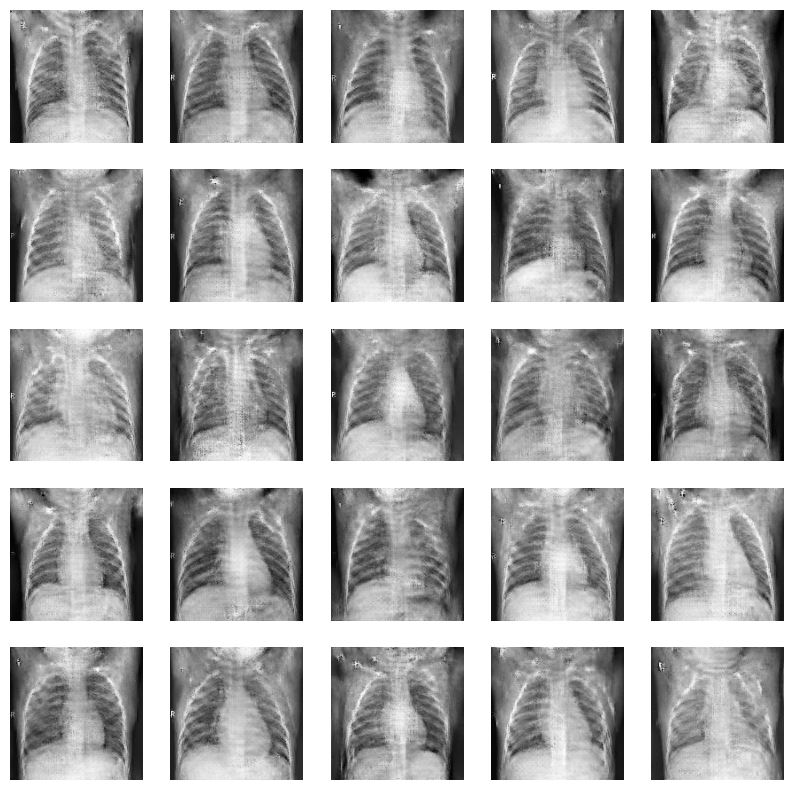

Epoch 371, Disc loss 0.1838925649994053, Generator loss 5.491655898094177
Epoch 372, Disc loss 0.18451334731653332, Generator loss 5.665376162528991
Epoch 373, Disc loss 0.190797261625994, Generator loss 5.619329559803009
Epoch 374, Disc loss 0.182865206443239, Generator loss 5.778320896625519
Epoch 375, Disc loss 0.18501560281729326, Generator loss 5.909072136878967
Epoch 376, Disc loss 0.1879336788551882, Generator loss 5.482776689529419
Epoch 377, Disc loss 0.18197647772030906, Generator loss 5.2776577234268185
Epoch 378, Disc loss 0.19261688650585712, Generator loss 5.565986597537995
Epoch 379, Disc loss 0.19051718537230045, Generator loss 5.414447975158692
Epoch 380, Disc loss 0.19258430360932835, Generator loss 5.089067685604095
1/1 [==============================] - 0s 17ms/step


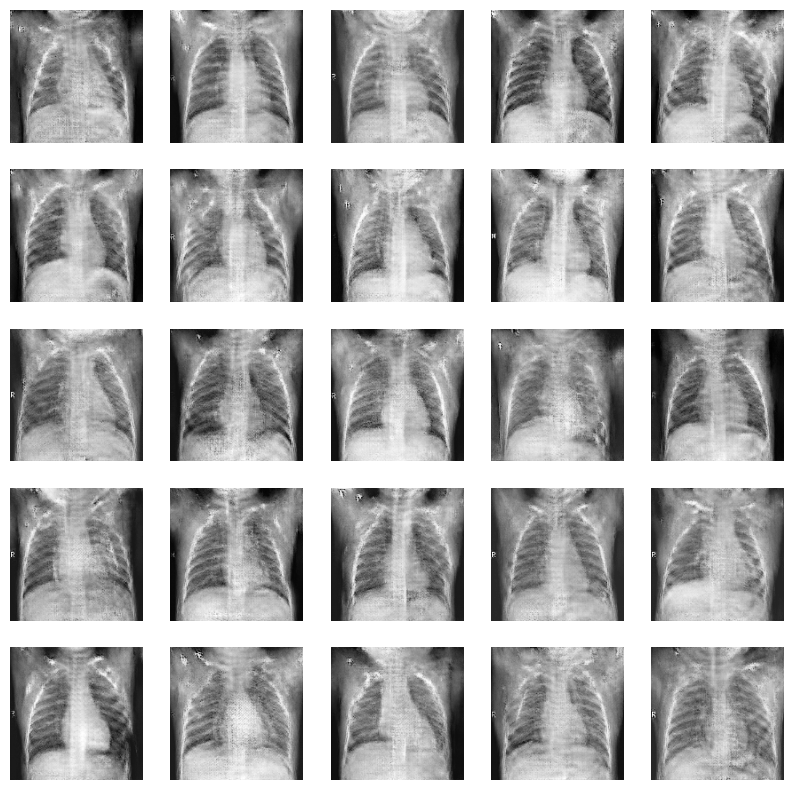

Epoch 381, Disc loss 0.2914943188952748, Generator loss 4.477353751659393
Epoch 382, Disc loss 0.2365949127590284, Generator loss 5.1929869771003725
Epoch 383, Disc loss 0.24126574997790157, Generator loss 6.0073440909385685
Epoch 384, Disc loss 0.377289534593001, Generator loss 5.476838052272797
Epoch 385, Disc loss 0.293032889906317, Generator loss 5.1121592164039615
Epoch 386, Disc loss 0.22399516586447135, Generator loss 6.213928842544556
Epoch 387, Disc loss 0.2049338573764544, Generator loss 6.567447209358216
Epoch 388, Disc loss 0.2038032380340155, Generator loss 6.519372200965881
Epoch 389, Disc loss 0.20833758015651255, Generator loss 6.199825644493103
Epoch 390, Disc loss 0.1725985098957608, Generator loss 7.3381088972091675
1/1 [==============================] - 0s 30ms/step


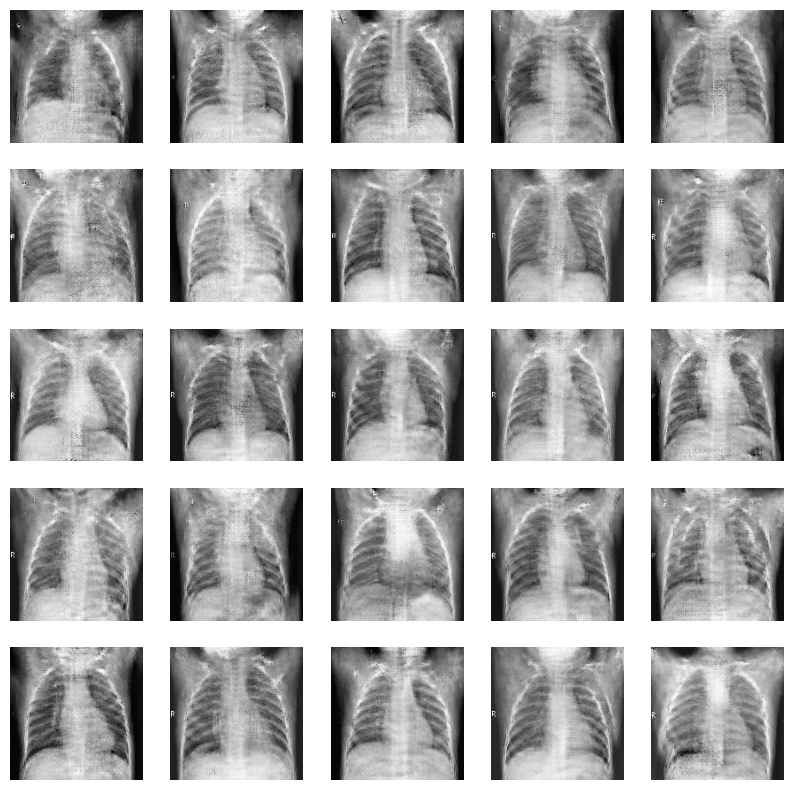

Epoch 391, Disc loss 0.18992006415501236, Generator loss 6.040986490249634
Epoch 392, Disc loss 0.2132937700022012, Generator loss 6.224879896640777
Epoch 393, Disc loss 0.23106681522913278, Generator loss 6.426525950431824
Epoch 394, Disc loss 0.1795488469360862, Generator loss 7.235327625274659
Epoch 395, Disc loss 0.221000029949937, Generator loss 6.463277506828308
Epoch 396, Disc loss 0.239337531325873, Generator loss 6.819736051559448
Epoch 397, Disc loss 0.19895664167124777, Generator loss 6.66102831363678
Epoch 398, Disc loss 0.21923525432357566, Generator loss 6.788956785202027
Epoch 399, Disc loss 0.19617226888076403, Generator loss 5.880363726615906
Epoch 400, Disc loss 0.19831327062565834, Generator loss 7.1498912334442135
1/1 [==============================] - 0s 18ms/step


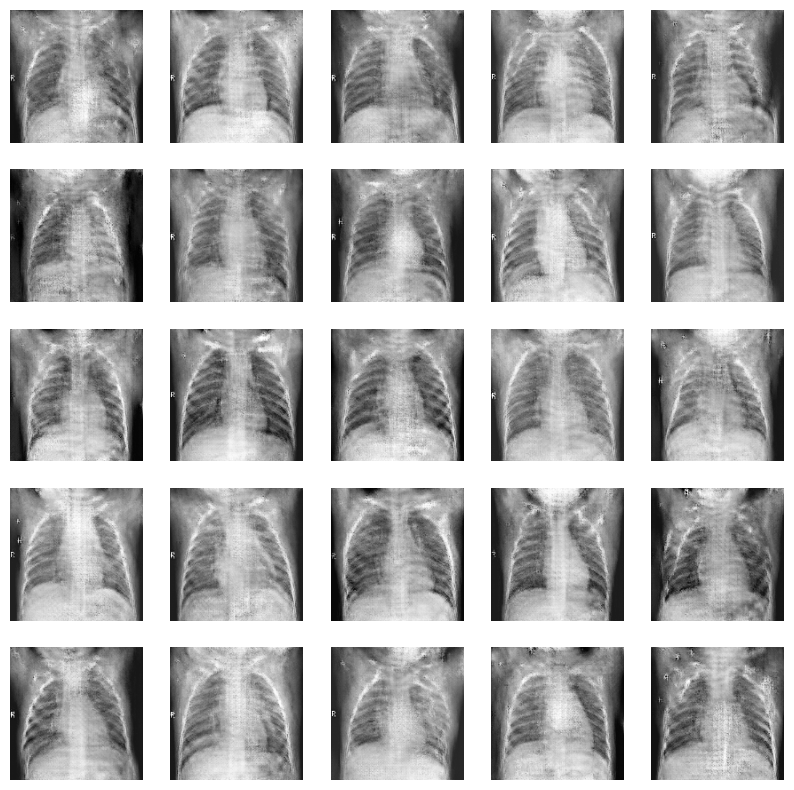

Epoch 401, Disc loss 0.24067768171662465, Generator loss 6.549261283874512
Epoch 402, Disc loss 0.222978110879194, Generator loss 6.321733808517456
Epoch 403, Disc loss 0.2042288732540328, Generator loss 7.012939238548279
Epoch 404, Disc loss 0.17501654218739587, Generator loss 7.853157043457031
Epoch 405, Disc loss 0.22930958693614228, Generator loss 6.770005869865417
Epoch 406, Disc loss 0.20459815092617645, Generator loss 6.673121476173401
Epoch 407, Disc loss 0.19499416868202388, Generator loss 7.151160550117493
Epoch 408, Disc loss 0.2031836636539083, Generator loss 7.300694227218628
Epoch 409, Disc loss 0.23774301042431034, Generator loss 7.301815366744995
Epoch 410, Disc loss 0.20263969414518215, Generator loss 6.439331531524658
1/1 [==============================] - 0s 17ms/step


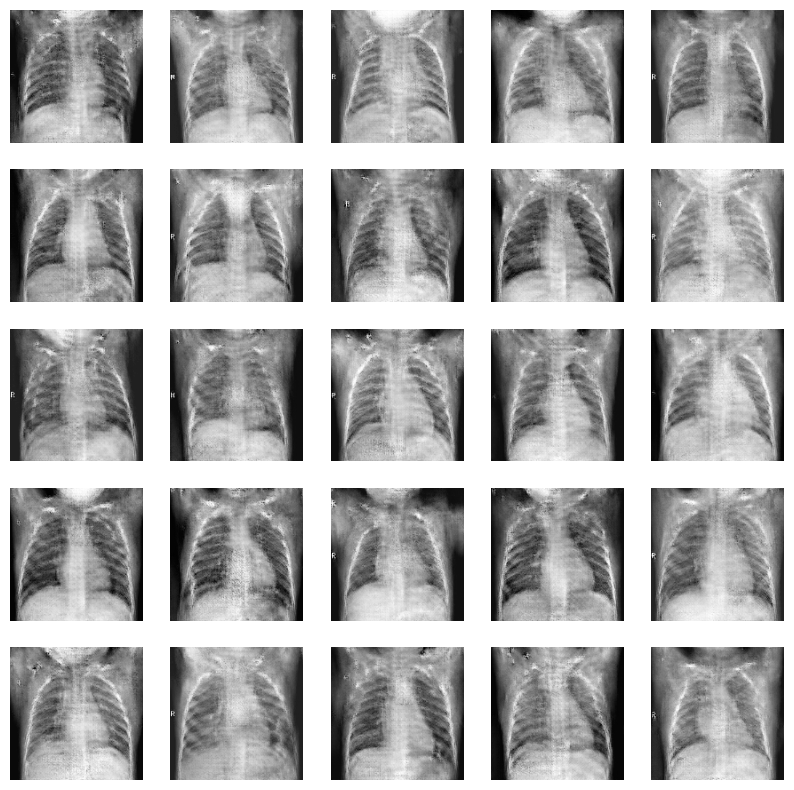

Epoch 411, Disc loss 0.2615581393656612, Generator loss 7.269755148887635
Epoch 412, Disc loss 0.24056305410922504, Generator loss 6.1962967872619625
Epoch 413, Disc loss 0.19854117489303463, Generator loss 7.117367696762085
Epoch 414, Disc loss 0.26046589063480496, Generator loss 5.9117431640625
Epoch 415, Disc loss 0.19386327062966302, Generator loss 7.041919994354248
Epoch 416, Disc loss 0.19800488139007938, Generator loss 7.177782011032105
Epoch 417, Disc loss 0.19693293332820758, Generator loss 6.611815476417542
Epoch 418, Disc loss 0.2460067997686565, Generator loss 6.313305902481079
Epoch 419, Disc loss 0.18065672286029438, Generator loss 7.5539734840393065
Epoch 420, Disc loss 0.18080709567639133, Generator loss 8.040705585479737
1/1 [==============================] - 0s 26ms/step


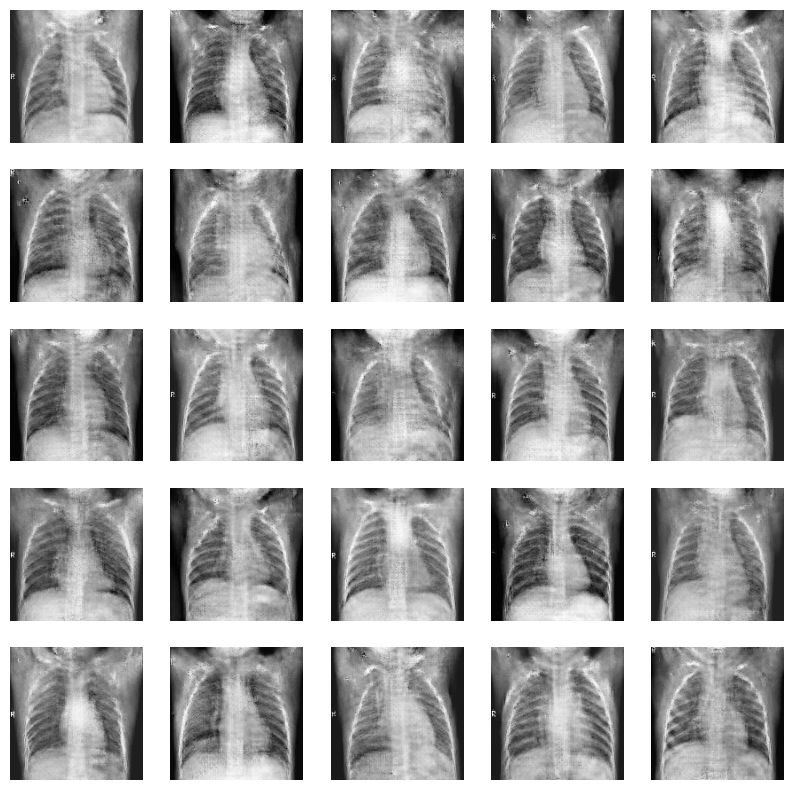

Epoch 421, Disc loss 0.24701817096793094, Generator loss 6.955354475975037
Epoch 422, Disc loss 0.1977851676638238, Generator loss 6.825175189971924
Epoch 423, Disc loss 0.18723903933423572, Generator loss 7.064439916610718
Epoch 424, Disc loss 0.16852213246822884, Generator loss 8.607841992378235
Epoch 425, Disc loss 0.2062713783729123, Generator loss 6.719831705093384
Epoch 426, Disc loss 0.19325052709318696, Generator loss 6.448624753952027
Epoch 427, Disc loss 0.20317631610669196, Generator loss 7.104963421821594
Epoch 428, Disc loss 0.1872684977048266, Generator loss 7.900284671783448
Epoch 429, Disc loss 0.2499801418161951, Generator loss 6.844885540008545
Epoch 430, Disc loss 0.21492909829248674, Generator loss 6.675743269920349
1/1 [==============================] - 0s 18ms/step


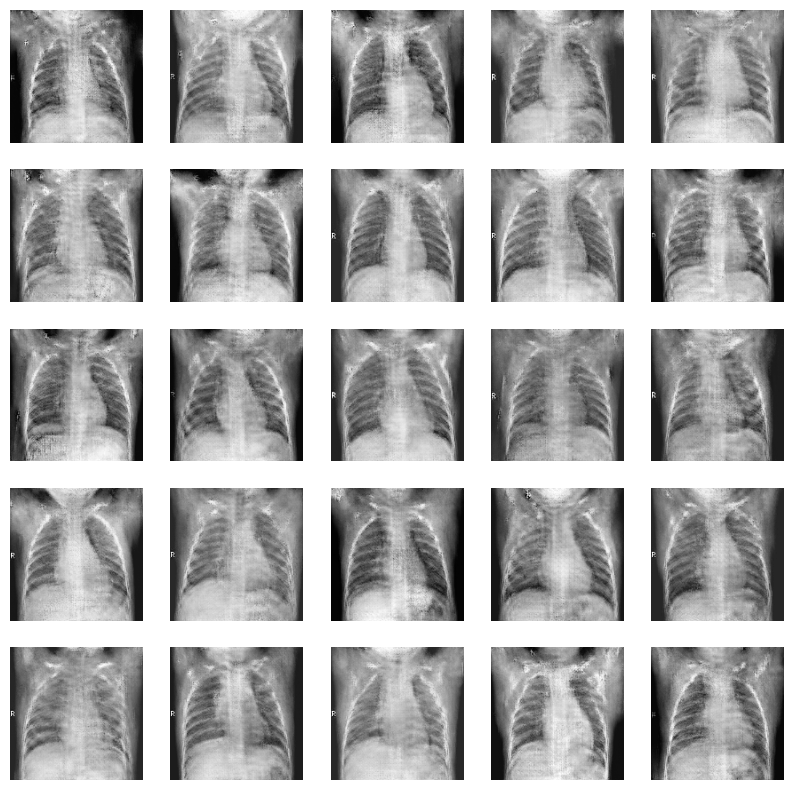

Epoch 431, Disc loss 0.23645885284058749, Generator loss 7.01486691236496
Epoch 432, Disc loss 0.18755266506923363, Generator loss 7.153909134864807
Epoch 433, Disc loss 0.21941983417491429, Generator loss 7.542639636993409
Epoch 434, Disc loss 0.18073231618618593, Generator loss 7.743086338043213
Epoch 435, Disc loss 0.22783939584041946, Generator loss 7.294295740127564
Epoch 436, Disc loss 0.21188586047501304, Generator loss 6.580914044380188
Epoch 437, Disc loss 0.22287524729035796, Generator loss 6.9662316799163815
Epoch 438, Disc loss 0.2010933486802969, Generator loss 7.390454864501953
Epoch 439, Disc loss 0.2824993268382968, Generator loss 6.609475946426391
Epoch 440, Disc loss 0.21720791043480858, Generator loss 6.536348676681518
1/1 [==============================] - 0s 18ms/step


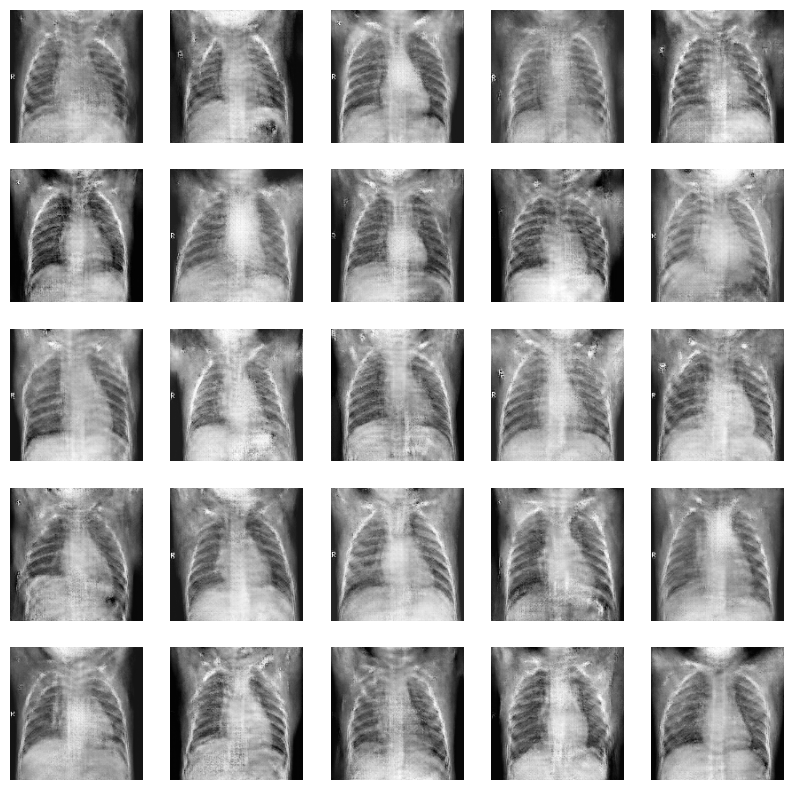

Epoch 441, Disc loss 0.18839808650955092, Generator loss 7.681834387779236
Epoch 442, Disc loss 0.23323676977233845, Generator loss 7.491855645179749
Epoch 443, Disc loss 0.19394082815852015, Generator loss 6.852135682106018
Epoch 444, Disc loss 0.209013343276456, Generator loss 6.983253645896911
Epoch 445, Disc loss 0.1797661854652688, Generator loss 7.0203276634216305
Epoch 446, Disc loss 0.3054796440585051, Generator loss 7.004534006118774
Epoch 447, Disc loss 0.19833645120379514, Generator loss 6.57334713935852
Epoch 448, Disc loss 0.19928391005378215, Generator loss 6.7124533414840695
Epoch 449, Disc loss 0.19578396794386208, Generator loss 6.891196608543396
Epoch 450, Disc loss 0.20630053301283624, Generator loss 7.565736889839172
1/1 [==============================] - 0s 19ms/step


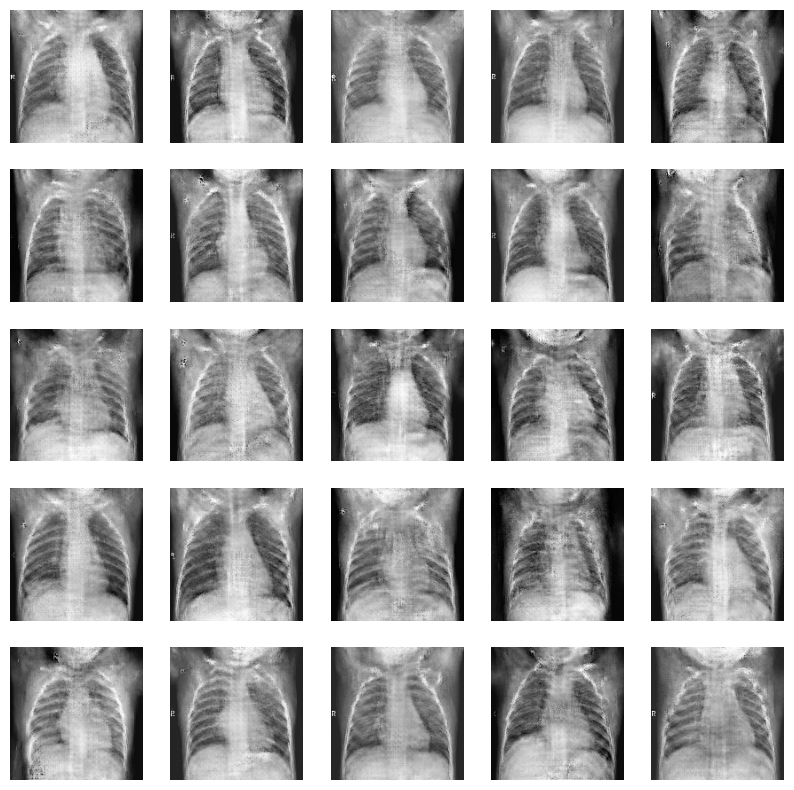

Epoch 451, Disc loss 0.188547417378868, Generator loss 7.886367011070251
Epoch 452, Disc loss 0.1961607112083584, Generator loss 7.144136524200439
Epoch 453, Disc loss 0.1836403530323878, Generator loss 6.900906133651733
Epoch 454, Disc loss 0.18170166033087298, Generator loss 8.632546043395996
Epoch 455, Disc loss 0.18983978259493597, Generator loss 6.86595606803894
Epoch 456, Disc loss 0.27627165656886066, Generator loss 6.748260712623596
Epoch 457, Disc loss 0.19520376464352013, Generator loss 6.906948709487915
Epoch 458, Disc loss 0.1935912902757991, Generator loss 8.117383742332459
Epoch 459, Disc loss 0.308327440766152, Generator loss 7.236343097686768
Epoch 460, Disc loss 0.17762200818397106, Generator loss 7.92394495010376
1/1 [==============================] - 0s 19ms/step


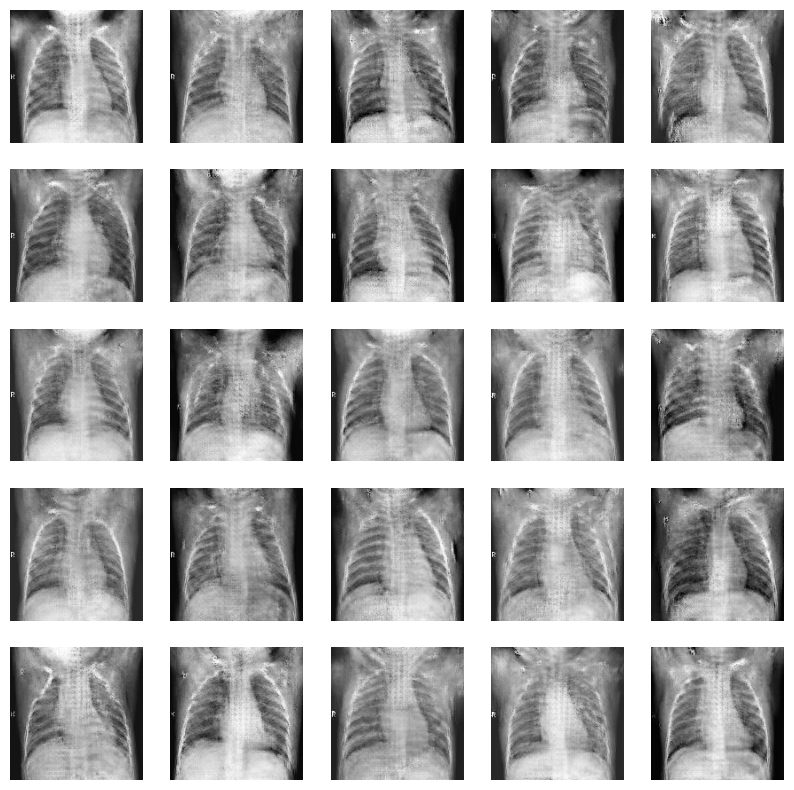

Epoch 461, Disc loss 0.2649130992766004, Generator loss 6.689533066749573
Epoch 462, Disc loss 0.24173523799981922, Generator loss 6.482591509819031
Epoch 463, Disc loss 0.18970032442884985, Generator loss 7.580178451538086
Epoch 464, Disc loss 0.2019536504027201, Generator loss 8.199151945114135
Epoch 465, Disc loss 0.21408924073912203, Generator loss 7.20991017818451
Epoch 466, Disc loss 0.22179267316823825, Generator loss 7.4502990484237674
Epoch 467, Disc loss 0.18624426451860926, Generator loss 7.83496880531311
Epoch 468, Disc loss 0.1713061134731106, Generator loss 8.557481026649475
Epoch 469, Disc loss 0.19226262629972551, Generator loss 8.47512445449829
Epoch 470, Disc loss 1.5635663216817193, Generator loss 7.871282207965851
1/1 [==============================] - 0s 29ms/step


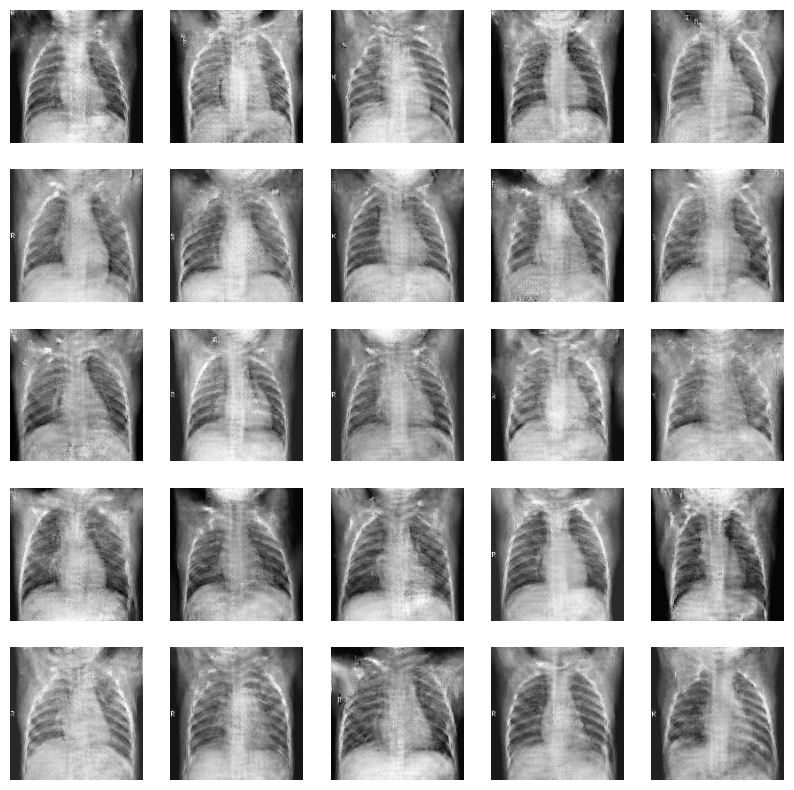

Epoch 471, Disc loss 0.5585036177188158, Generator loss 2.8057857394218444
Epoch 472, Disc loss 0.392334308847785, Generator loss 3.561009967327118
Epoch 473, Disc loss 0.32290277164429426, Generator loss 5.121542620658874
Epoch 474, Disc loss 0.27310816696845, Generator loss 5.821750831604004
Epoch 475, Disc loss 0.25834115156903864, Generator loss 5.9961039304733275
Epoch 476, Disc loss 0.2339770078426227, Generator loss 6.044346857070923
Epoch 477, Disc loss 0.20752309727249668, Generator loss 6.719921875
Epoch 478, Disc loss 0.2302826660918072, Generator loss 5.803851699829101
Epoch 479, Disc loss 0.1957975140423514, Generator loss 6.529760694503784
Epoch 480, Disc loss 0.21540080842678436, Generator loss 6.6921701669693
1/1 [==============================] - 0s 18ms/step


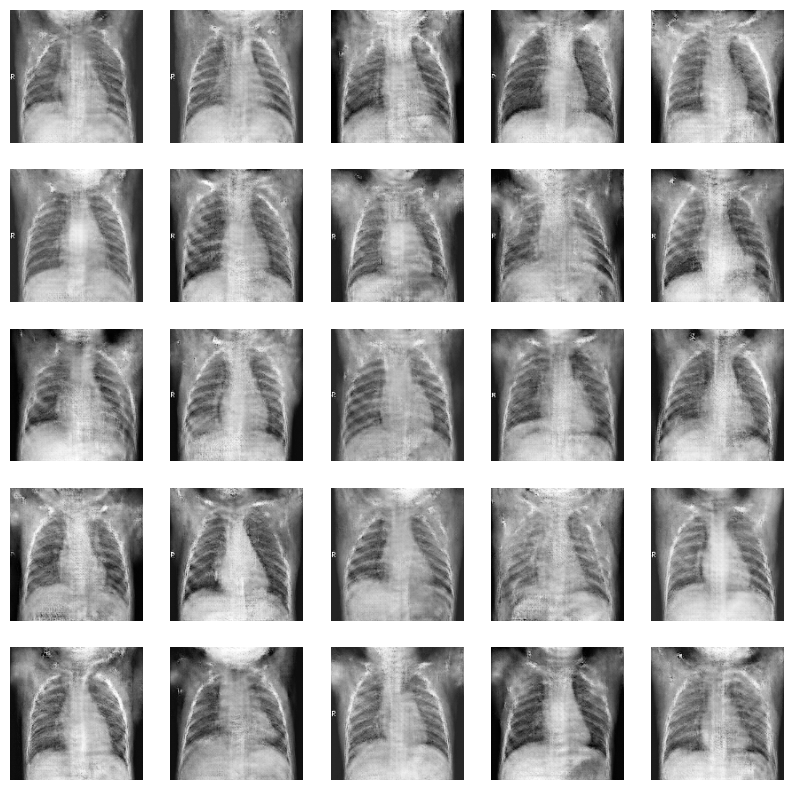

Epoch 481, Disc loss 0.16979916911805049, Generator loss 7.562032437324524
Epoch 482, Disc loss 0.17263703646603973, Generator loss 6.008406352996826
Epoch 483, Disc loss 0.1780813872930594, Generator loss 5.668226170539856
Epoch 484, Disc loss 0.17780163645511493, Generator loss 6.233501982688904
Epoch 485, Disc loss 0.18207038448890672, Generator loss 6.055835199356079
Epoch 486, Disc loss 0.17440168403554707, Generator loss 6.323615312576294
Epoch 487, Disc loss 0.17569679243606515, Generator loss 6.660778069496155
Epoch 488, Disc loss 0.17678649361478166, Generator loss 6.648237204551696
Epoch 489, Disc loss 0.17923867907666136, Generator loss 6.368248391151428
Epoch 490, Disc loss 0.17817319212772417, Generator loss 6.791028547286987
1/1 [==============================] - 0s 21ms/step


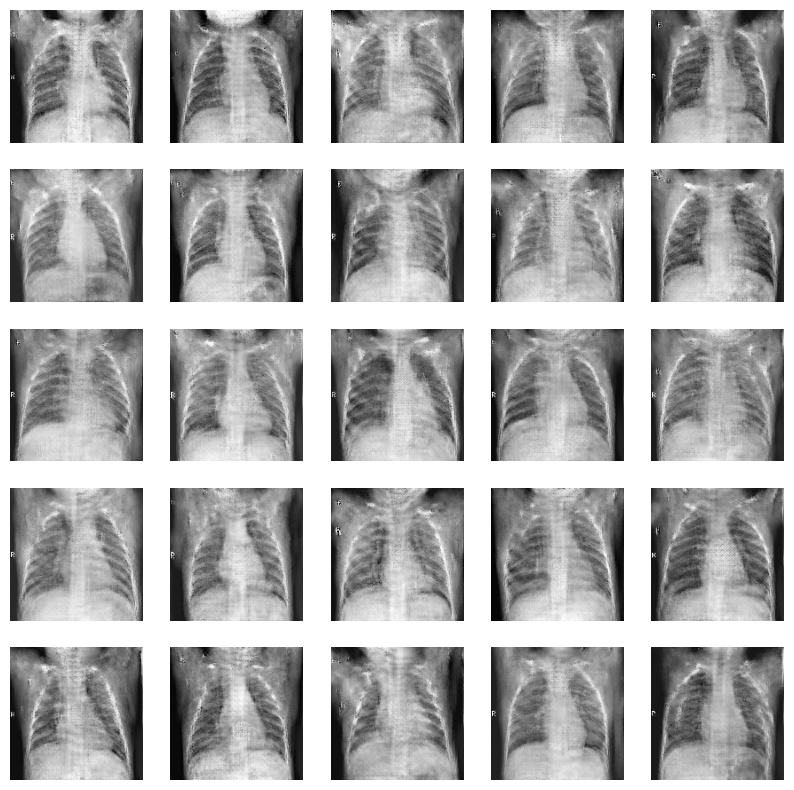

Epoch 491, Disc loss 0.17395459038089028, Generator loss 6.60822548866272
Epoch 492, Disc loss 0.17591513230581768, Generator loss 6.967009019851685
Epoch 493, Disc loss 0.17731194376247003, Generator loss 6.328616714477539
Epoch 494, Disc loss 0.17950049045030028, Generator loss 6.413589262962342
Epoch 495, Disc loss 0.17562937518232502, Generator loss 6.623466897010803
Epoch 496, Disc loss 0.1763246483867988, Generator loss 6.399043619632721
Epoch 497, Disc loss 0.1812627054634504, Generator loss 6.37364981174469
Epoch 498, Disc loss 0.17970016773906536, Generator loss 6.224747955799103
Epoch 499, Disc loss 0.18006225561257452, Generator loss 6.187664914131164
Epoch 500, Disc loss 0.18212682036682964, Generator loss 6.360088992118835
1/1 [==============================] - 0s 27ms/step


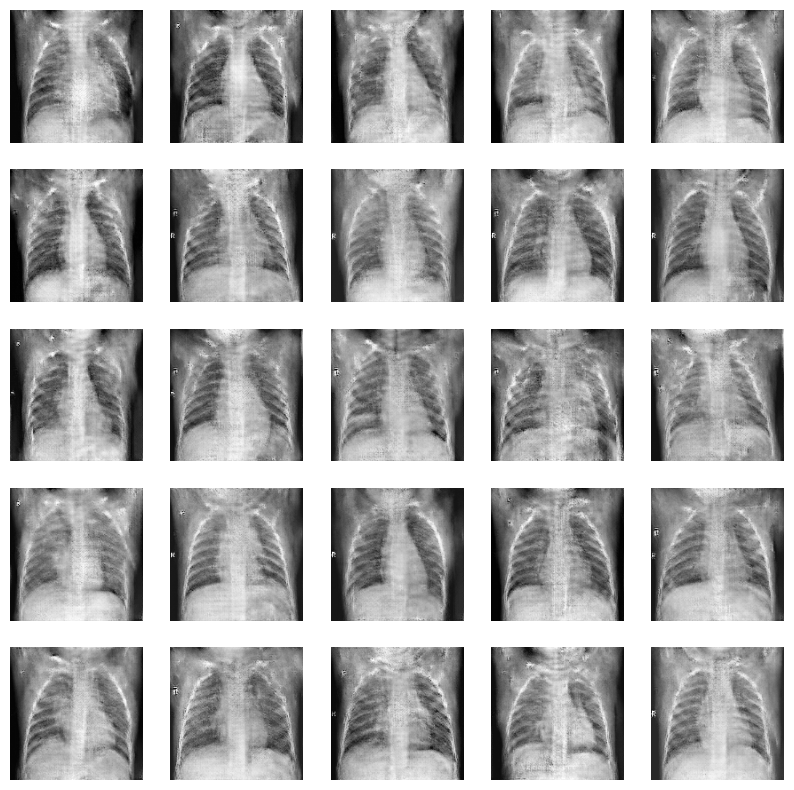

In [ ]:
# Training Loop

d_losses = []
g_losses = []

for epoch in range(total_epochs):
  epoch_d_loss = 0.0
  epoch_g_loss = 0.0

  # mini batch gd

  for step in range(no_of_batches):

    # Train descriminator
    descriminator.trainable = True
    idx = np.random.randint(0,1341,half_batch)
    real_imgs = x_train_normal[idx]

    noise = np.random.normal(0,1,size=(half_batch,noise_dim))
    fake_imgs = generator.predict(noise, verbose=0)

    real_y = np.ones((half_batch,1))*0.9
    fake_y = np.zeros((half_batch,1))

    d_loss_real = descriminator.train_on_batch(real_imgs, real_y)
    d_loss_fake = descriminator.train_on_batch(fake_imgs, fake_y)

    d_loss = 0.5*d_loss_real + 0.5*d_loss_fake
    epoch_d_loss += d_loss

    # Train generator

    descriminator.trainable = False
    noise = np.random.normal(0,1,size=(batch_size,noise_dim))
    ground_truth_y = np.ones((batch_size,1))
    g_loss = model.train_on_batch(noise,ground_truth_y,)
    epoch_g_loss += g_loss

  print(f"Epoch {epoch+1}, Disc loss {epoch_d_loss/no_of_batches}, Generator loss {epoch_g_loss/no_of_batches}")

  d_losses.append(epoch_d_loss/no_of_batches)
  g_losses.append(epoch_g_loss/no_of_batches)

  if (epoch+1)%10 == 0:
    generator.save("generator.h5")
    display_images()


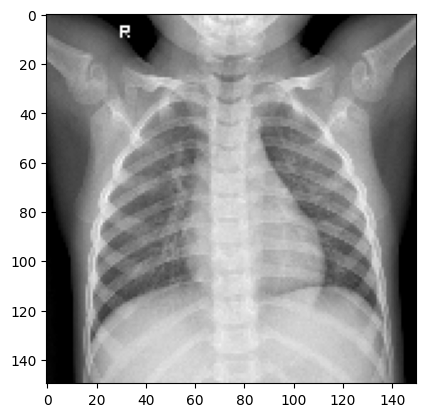

In [ ]:
plt.imshow(train[5000][0], 'gray')

In [ ]:
noise = np.random.normal(0,1,size = (1,noise_dim))
generated_img = generator.predict(noise)

1/1 [==============================] - 0s 27ms/step


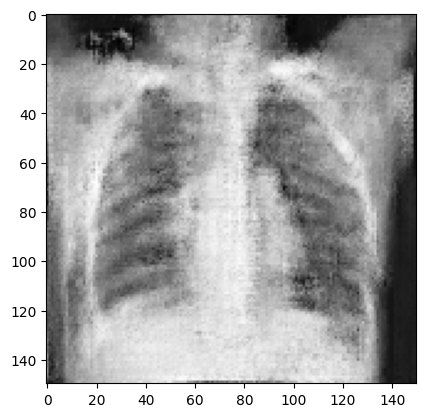

In [ ]:
plt.imshow(generated_img.reshape(150,150),'gray')  # kernel size 3x3

1/1 [==============================] - 0s 218ms/step


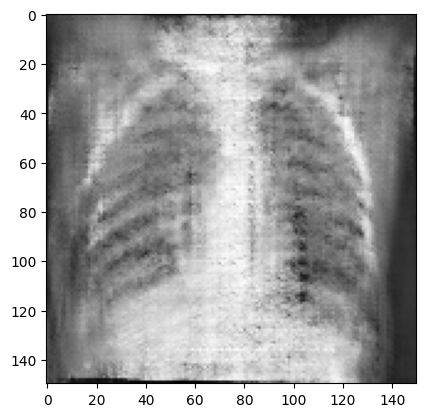

In [ ]:
noise = np.random.normal(0,1,size = (1,noise_dim))
generated_img = generator.predict(noise)
plt.imshow(generated_img.reshape(150,150),'gray')  # kernel size 4x4

1/1 [==============================] - 0s 94ms/step


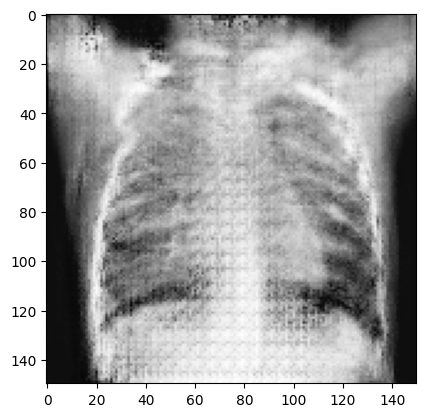

In [ ]:
noise = np.random.normal(0,1,size = (1,noise_dim))
generated_img = generator.predict(noise)
plt.imshow(generated_img.reshape(150,150),'gray')  # kernel size 5x5

1/1 [==============================] - 0s 31ms/step


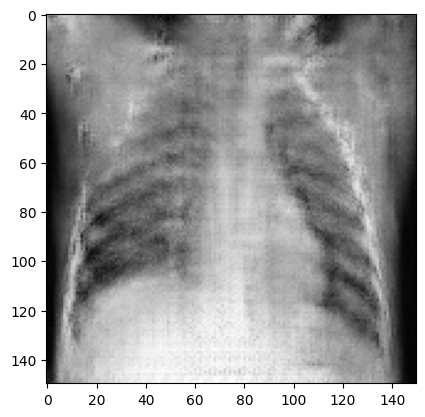

In [ ]:
noise = np.random.normal(0,1,size = (1,noise_dim))
generated_img = generator.predict(noise)
plt.imshow(generated_img.reshape(150,150),'gray')  # kernel size 5x5 new 16-08-23

1/1 [==============================] - 0s 20ms/step


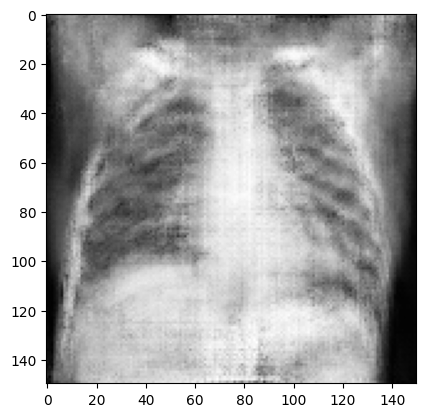

In [ ]:
noise = np.random.normal(0,1,size = (1,noise_dim))
generated_img = generator.predict(noise)
plt.imshow(generated_img.reshape(150,150),'gray')  # kernel size 5x5 new 29-09-23 c

1/1 [==============================] - 0s 24ms/step


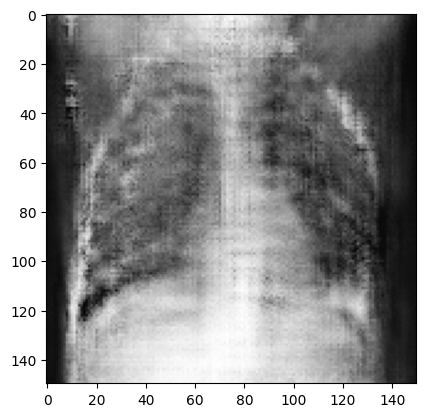

In [ ]:
noise = np.random.normal(0,1,size = (1,noise_dim))
generated_img = generator.predict(noise)
plt.imshow(generated_img.reshape(150,150),'gray')  # kernel size 5x5 new 29-09-23 (this (with all above) with lr=0.0002)

1/1 [==============================] - 0s 102ms/step


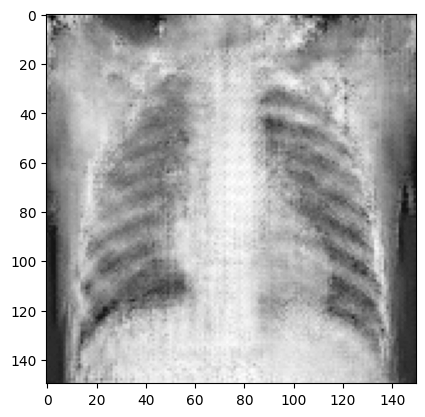

In [ ]:
noise = np.random.normal(0,1,size = (1,noise_dim))
generated_img = generator.predict(noise)
plt.imshow(generated_img.reshape(150,150),'gray') # kernel size 5x5 new 03-10-23 500 epochs

1/1 [==============================] - 0s 21ms/step


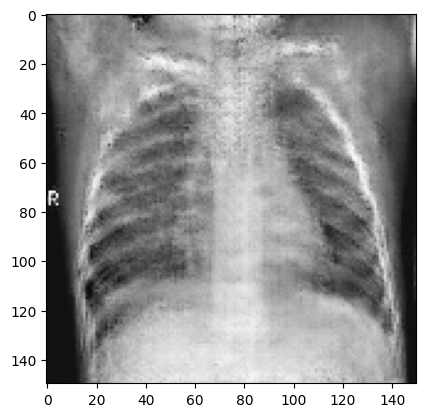

In [ ]:
noise = np.random.normal(0,1,size = (1,noise_dim))
generated_img = generator.predict(noise)
plt.imshow(generated_img.reshape(150,150),'gray') # kernel size 5x5 new 03-10-23 1000 epochs

In [ ]:
# https://github.com/keras-team/keras/issues/10806#issuecomment-524565808

In [ ]:
def save(gan, generator, descriminator):
    descriminator.trainable = False
    save_model(gan, 'gan')
    descriminator.trainable = True
    save_model(generator, 'generator')
    save_model(descriminator, 'descriminator')


def load():
    descriminator = load_model('descriminator')
    generator = load_model('generator')
    gan = load_model('gan')
    gan.summary()
    descriminator.summary()
    generator.summary()

    return gan, generator, descriminator

In [ ]:
save(model, generator, descriminator)

In [ ]:
model, generator, descriminator = load()

Model: "model_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_11 (InputLayer)       [(None, 100)]             0         
                                                                 
 sequential_20 (Sequential)  (None, 150, 150, 1)       8287233   
                                                                 
 sequential_21 (Sequential)  (None, 1)                 8206793   
                                                                 
Total params: 16494026 (62.92 MB)
Trainable params: 8286849 (31.61 MB)
Non-trainable params: 8207177 (31.31 MB)
_________________________________________________________________
Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_20 (Conv2D)          (None, 50, 50, 64)        1664      
                                                       